
MULTI-KERNEL SATELLITE IMAGE RETRIEVAL WITH PATCH MERGING
Kernel sizes to compare: [(75, 75), (85, 85), (95, 95)]
Loading DINOv3 model: facebook/dinov3-vitb16-pretrain-lvd1689m
DINOv3 model loaded. Hidden size: 768

📁 Dataset: 8 images

STEP 1: Processing Dataset with All Kernel Sizes
Processing dataset with 3 kernel sizes

Processing with kernel size: 75×75


Processing (75, 75): 100%|██████████| 8/8 [00:30<00:00,  3.82s/it]


Building index: 12250 patches, dim 768
Saved index for kernel (75, 75)
✅ Completed: 12250 patches

Processing with kernel size: 85×85


Processing (85, 85): 100%|██████████| 8/8 [00:24<00:00,  3.01s/it]


Building index: 9513 patches, dim 768
Saved index for kernel (85, 85)
✅ Completed: 9513 patches

Processing with kernel size: 95×95


Processing (95, 95): 100%|██████████| 8/8 [00:20<00:00,  2.60s/it]


Building index: 7472 patches, dim 768
Saved index for kernel (95, 95)
✅ Completed: 7472 patches

🔍 Query image: 03.png

STEP 2: Searching with All Kernel Sizes

Searching with all kernel sizes

🔍 Searching with kernel 75×75...
  ✅ Found 15 results. Top score: 0.6606

🔍 Searching with kernel 85×85...
  ✅ Found 15 results. Top score: 0.5859

🔍 Searching with kernel 95×95...
  ✅ Found 15 results. Top score: 0.6150

STEP 3: Separate Visualizations for Each Kernel

Creating separate visualizations for each kernel size

📊 Visualizing kernel 75×75


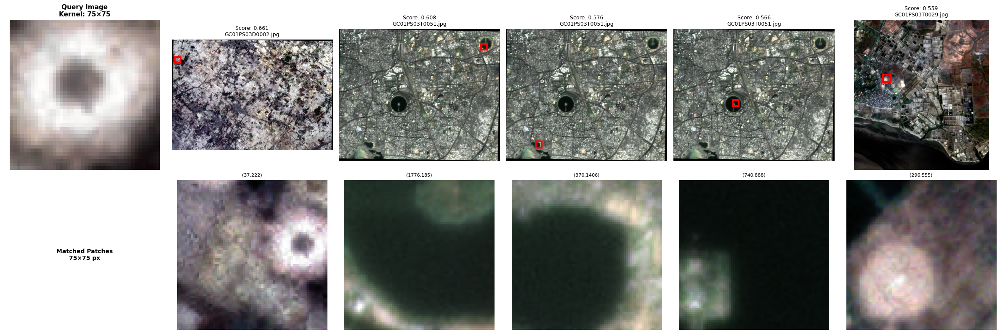


📊 Visualizing kernel 85×85


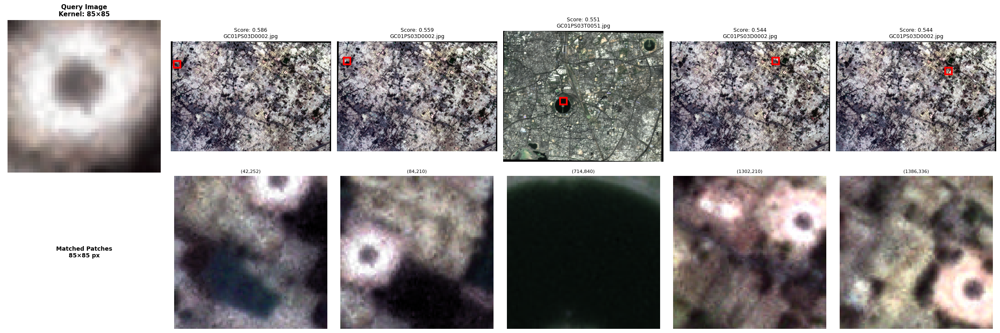


📊 Visualizing kernel 95×95


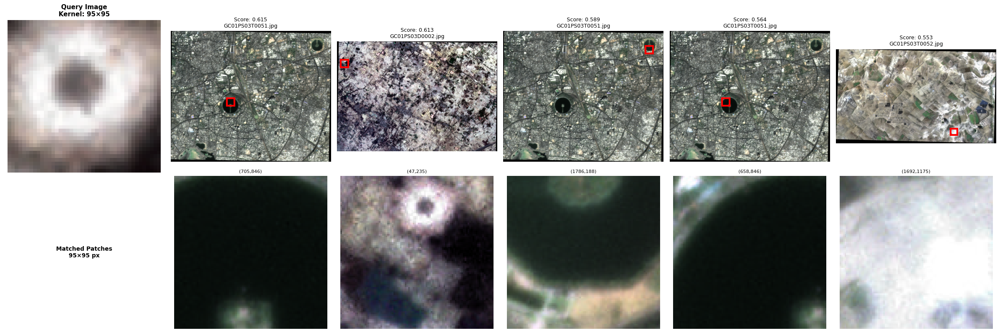


STEP 4: Combined Visualization (All Kernels in One Figure)

Creating COMBINED visualization with all kernel sizes


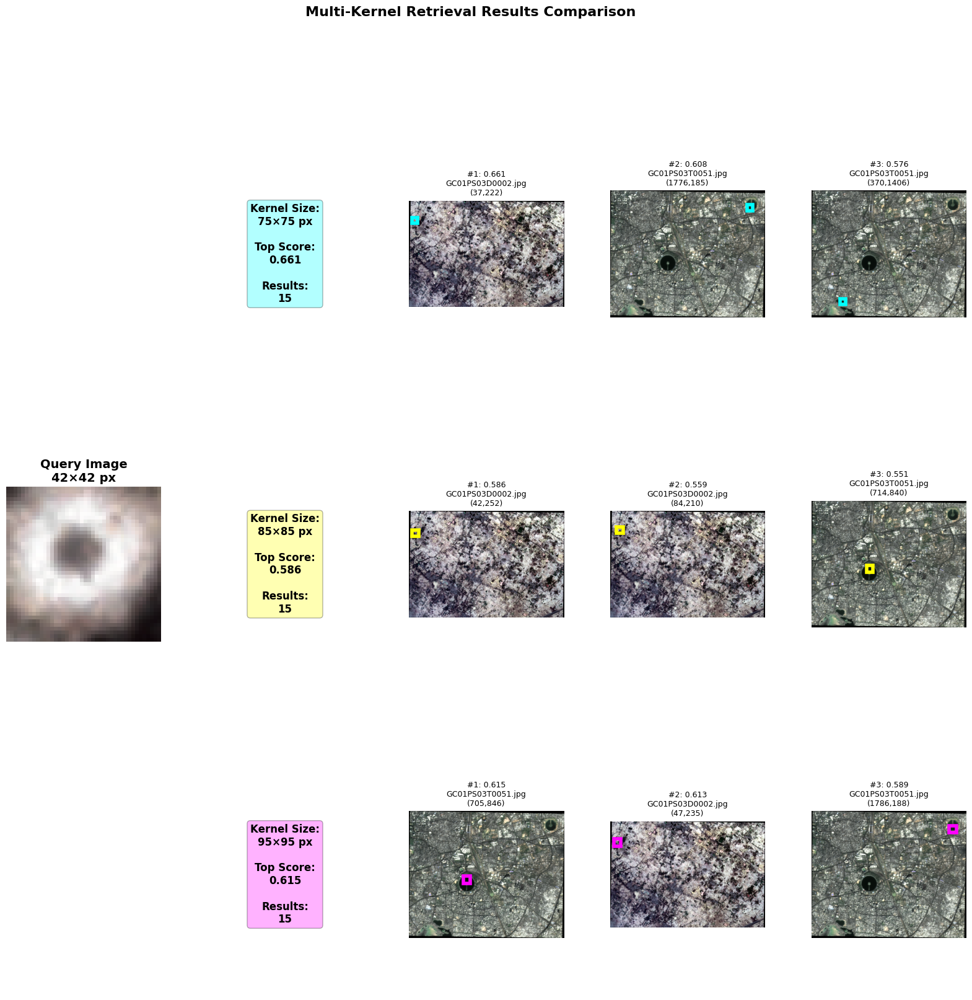


STEP 5: Merge Overlapping Patches from All Kernels

MERGING OVERLAPPING PATCHES FROM ALL KERNELS
Total patches across all kernels: 45
After merging: 22 unified regions

📊 Merged Patches Summary:
  1. GC01PS03D0002.jpg
     Size: 152×115 px | Scores: avg=0.592, max=0.661
     Combined from 4 patches (kernels: 85×85, 95×95, 75×75)
  2. GC01PS03T0051.jpg
     Size: 75×75 px | Scores: avg=0.576, max=0.576
     Combined from 1 patches (kernels: 75×75)
  3. GC01PS03T0051.jpg
     Size: 75×75 px | Scores: avg=0.566, max=0.566
     Combined from 1 patches (kernels: 75×75)
  4. GC01PS03T0051.jpg
     Size: 149×98 px | Scores: avg=0.559, max=0.608
     Combined from 4 patches (kernels: 95×95, 75×75)
  5. GC01PS03D0002.jpg
     Size: 85×85 px | Scores: avg=0.559, max=0.559
     Combined from 1 patches (kernels: 85×85)
  6. GC01PS03T0052.jpg
     Size: 95×95 px | Scores: avg=0.553, max=0.553
     Combined from 1 patches (kernels: 95×95)
  7. GC01PS03T0029.jpg
     Size: 85×85 px | Scores: avg=0.5

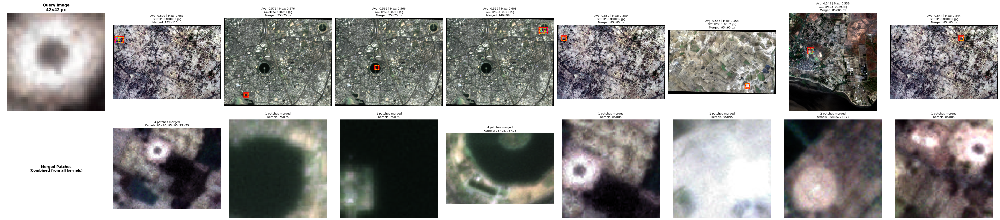


SUMMARY

✅ Completed all steps:
  1. ✓ Processed dataset with 3 kernel sizes (75×75, 85×85, 95×95)
  2. ✓ Searched query against all kernel databases
  3. ✓ Created separate visualizations for each kernel size
  4. ✓ Created combined visualization with all kernels
  5. ✓ Merged overlapping patches into unified regions

📊 Results breakdown:
  Kernel 75×75: 15 matches
  Kernel 85×85: 15 matches
  Kernel 95×95: 15 matches

🔗 Total merged regions: 22
  Reduced from 45 individual patches

All visualizations saved! Check your working directory.


In [1]:
"""
Multi-Kernel Size Comparison and Patch Merging System
======================================================
Features:
1. Compare results across multiple kernel sizes (75×75, 85×85, 95×95)
2. Visualize results separately for each kernel size
3. Combine all three kernel results in one comprehensive view
4. Merge overlapping patches into single unified patches
5. Display merged patches on source images
"""

import os
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from typing import List, Tuple, Dict, Optional, Union, Any
from dataclasses import dataclass
from pathlib import Path
import cv2
from PIL import Image
import faiss
from tqdm import tqdm
import json
import pickle
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from collections import defaultdict
import warnings
warnings.filterwarnings('ignore')


# ---- MULTIPLE KERNEL SIZES FOR COMPARISON ----
KERNEL_SIZES = [(75, 75), (85, 85), (95, 95)]


# ---- dataclasses ----
@dataclass
class PatchInfo:
    """Store information about a patch"""
    image_path: str
    image_idx: int
    x: int
    y: int
    width: int
    height: int
    kernel_size: Tuple[int, int]
    embedding: Optional[np.ndarray] = None


@dataclass
class RetrievalResult:
    """Store retrieval results"""
    patch_info: PatchInfo
    similarity_score: float
    query_patch_info: Optional[Dict[str, Any]] = None


@dataclass
class MergedPatch:
    """Represents a merged patch from overlapping patches"""
    image_path: str
    x_min: int
    y_min: int
    x_max: int
    y_max: int
    width: int
    height: int
    contributing_patches: List[RetrievalResult]
    avg_score: float
    max_score: float
    kernel_sizes: List[Tuple[int, int]]


# ---- SatelliteModelWrapper ----
class SatelliteModelWrapper:
    """Wrapper for satellite image models with proper DINOv3 handling."""

    def __init__(self, model_name: str = "dinov3", device: str = "cuda"):
        self.device = torch.device(device if torch.cuda.is_available() else "cpu")
        self.model_name = model_name.lower()
        self.processor = None
        self.model = None
        self.preprocess = None
        self.model, self.preprocess = self._load_model()

    def _load_model(self):
        """Load the specified satellite image model"""
        if self.model_name == "dinov2":
            model = torch.hub.load('facebookresearch/dinov2', 'dinov2_vits14')
            model = model.to(self.device)
            model.eval()

            from torchvision import transforms
            preprocess = transforms.Compose([
                transforms.Resize(224),
                transforms.CenterCrop(224),
                transforms.ToTensor(),
                transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])
            ])

        elif self.model_name == "dinov3":
            from transformers import AutoImageProcessor, AutoModel

            pretrained_model_name = "facebook/dinov3-vitb16-pretrain-lvd1689m"
            print(f"Loading DINOv3 model: {pretrained_model_name}")

            self.processor = AutoImageProcessor.from_pretrained(pretrained_model_name)
            model = AutoModel.from_pretrained(pretrained_model_name)
            model = model.to(self.device)
            model.eval()

            print(f"DINOv3 model loaded. Hidden size: {model.config.hidden_size}")

            def preprocess(image: Image.Image) -> Dict[str, torch.Tensor]:
                if image.mode != 'RGB':
                    image = image.convert('RGB')
                inputs = self.processor(images=image, return_tensors="pt")
                return inputs

            preprocess = preprocess

        else:
            raise ValueError(f"Unsupported model: {self.model_name}")

        return model, preprocess

    @torch.no_grad()
    def extract_features(self, images: Union[torch.Tensor, np.ndarray, Dict[str, torch.Tensor]]) -> np.ndarray:
        """Extract features with proper handling for all input types"""
        if self.model_name == "dinov3":
            if not isinstance(images, dict):
                raise ValueError("DINOv3 requires a dict input from the processor.")

            inputs = {k: v.to(self.device) for k, v in images.items()}
            outputs = self.model(**inputs)

            if hasattr(outputs, "last_hidden_state") and outputs.last_hidden_state is not None:
                cls_embeddings = outputs.last_hidden_state[:, 0]
                features = cls_embeddings
            elif hasattr(outputs, "pooler_output") and outputs.pooler_output is not None:
                features = outputs.pooler_output
            else:
                last = outputs.last_hidden_state
                features = last[:, 1:].mean(dim=1)

            features = torch.nn.functional.normalize(features, p=2, dim=1)
            return features.cpu().numpy()

        else:
            if isinstance(images, np.ndarray):
                images = torch.from_numpy(images).to(self.device)
            elif isinstance(images, torch.Tensor):
                images = images.to(self.device)

            features = self.model(images)

            if isinstance(features, dict):
                if 'x_norm_clstoken' in features:
                    features = features['x_norm_clstoken']
                elif 'x_norm_patchtokens' in features:
                    features = features['x_norm_patchtokens'].mean(dim=1)
                elif 'pooled' in features:
                    features = features['pooled']
                else:
                    features = features.get('last_hidden_state', features).mean(dim=1)
            else:
                if features.ndim == 4:
                    features = features.squeeze(-1).squeeze(-1)
                elif features.ndim == 2:
                    pass
                else:
                    features = features.view(features.shape[0], -1)

            if isinstance(features, torch.Tensor):
                features = torch.nn.functional.normalize(features, p=2, dim=1)

            return features.cpu().numpy()


# ---- Fixed Kernel PatchDataset ----
class FixedKernelPatchDataset(Dataset):
    """Dataset for loading patches with specific kernel size"""

    def __init__(self, image_path: str, kernel_size: Tuple[int, int],
                 stride: Tuple[int, int] = None, transform=None, min_patch_std: float = 5.0):
        self.image_path = image_path
        self.kernel_size = kernel_size
        self.stride = stride if stride else (kernel_size[0] // 2, kernel_size[1] // 2)
        self.transform = transform
        self.min_patch_std = min_patch_std

        self.image = cv2.imread(image_path)
        if self.image is None:
            raise ValueError(f"Could not load image: {image_path}")
        self.image = cv2.cvtColor(self.image, cv2.COLOR_BGR2RGB)
        self.h, self.w = self.image.shape[:2]

        self.patches = []
        for y in range(0, max(1, self.h - kernel_size[1] + 1), self.stride[1]):
            for x in range(0, max(1, self.w - kernel_size[0] + 1), self.stride[0]):
                patch = self.image[y:y + kernel_size[1], x:x + kernel_size[0]]

                if patch.shape[0] == kernel_size[1] and patch.shape[1] == kernel_size[0]:
                    if np.std(patch) > self.min_patch_std:
                        self.patches.append((x, y))

    def __len__(self):
        return len(self.patches)

    def __getitem__(self, idx):
        x, y = self.patches[idx]
        patch = self.image[y:y + self.kernel_size[1], x:x + self.kernel_size[0]]

        if self.transform:
            pil = Image.fromarray(patch)
            transformed = self.transform(pil)
        else:
            pil = Image.fromarray(patch)
            transformed = pil

        return transformed, (x, y)


# ---- Query Image Handler ----
class QueryImageHandler:
    """Handle variable-sized query images"""

    @staticmethod
    def extract_query_patches(query_image: Union[str, np.ndarray],
                             kernel_size: Tuple[int, int],
                             stride_ratio: float = 0.5) -> List[Dict[str, Any]]:
        """Extract fixed-size patches from a query image"""
        if isinstance(query_image, str):
            img = cv2.imread(query_image)
            if img is None:
                raise ValueError(f"Could not load query image: {query_image}")
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        else:
            img = query_image.copy()

        h, w = img.shape[:2]
        patches = []

        if h < kernel_size[1] or w < kernel_size[0]:
            scale = max(kernel_size[1] / h, kernel_size[0] / w)
            new_h, new_w = int(h * scale), int(w * scale)
            img = cv2.resize(img, (new_w, new_h), interpolation=cv2.INTER_LINEAR)
            h, w = new_h, new_w

        stride = (max(1, int(kernel_size[0] * (1 - stride_ratio))),
                 max(1, int(kernel_size[1] * (1 - stride_ratio))))

        patch_count = 0
        for y in range(0, max(1, h - kernel_size[1] + 1), stride[1]):
            for x in range(0, max(1, w - kernel_size[0] + 1), stride[0]):
                patch = img[y:y + kernel_size[1], x:x + kernel_size[0]]

                if patch.shape[0] == kernel_size[1] and patch.shape[1] == kernel_size[0]:
                    patches.append({
                        'image': patch,
                        'x': x,
                        'y': y,
                        'width': kernel_size[0],
                        'height': kernel_size[1],
                        'patch_id': patch_count,
                        'original_size': (h, w)
                    })
                    patch_count += 1

        if len(patches) == 0:
            center_x = max(0, (w - kernel_size[0]) // 2)
            center_y = max(0, (h - kernel_size[1]) // 2)
            patch = img[center_y:center_y + kernel_size[1], center_x:center_x + kernel_size[0]]

            if patch.shape[0] < kernel_size[1] or patch.shape[1] < kernel_size[0]:
                pad_h = max(0, kernel_size[1] - patch.shape[0])
                pad_w = max(0, kernel_size[0] - patch.shape[1])
                patch = cv2.copyMakeBorder(patch, 0, pad_h, 0, pad_w, cv2.BORDER_REFLECT)

            patches.append({
                'image': patch,
                'x': center_x,
                'y': center_y,
                'width': kernel_size[0],
                'height': kernel_size[1],
                'patch_id': 0,
                'original_size': (h, w)
            })

        return patches


# ---- NEW: Patch Merger Class ----
class PatchMerger:
    """Merge overlapping patches into unified regions"""

    @staticmethod
    def compute_iou(patch1: Union[PatchInfo, RetrievalResult], 
                    patch2: Union[PatchInfo, RetrievalResult]) -> float:
        """Compute IoU between two patches"""
        # Extract PatchInfo if RetrievalResult
        p1 = patch1.patch_info if isinstance(patch1, RetrievalResult) else patch1
        p2 = patch2.patch_info if isinstance(patch2, RetrievalResult) else patch2

        x1_min, y1_min = p1.x, p1.y
        x1_max, y1_max = x1_min + p1.width, y1_min + p1.height

        x2_min, y2_min = p2.x, p2.y
        x2_max, y2_max = x2_min + p2.width, y2_min + p2.height

        x_inter_min = max(x1_min, x2_min)
        y_inter_min = max(y1_min, y2_min)
        x_inter_max = min(x1_max, x2_max)
        y_inter_max = min(y1_max, y2_max)

        if x_inter_max <= x_inter_min or y_inter_max <= y_inter_min:
            return 0.0

        intersection = (x_inter_max - x_inter_min) * (y_inter_max - y_inter_min)
        area1 = p1.width * p1.height
        area2 = p2.width * p2.height
        union = area1 + area2 - intersection
        return intersection / union if union > 0 else 0.0

    @staticmethod
    def merge_overlapping_patches(results: List[RetrievalResult], 
                                 iou_threshold: float = 0.3) -> List[MergedPatch]:
        """
        Merge overlapping patches from same image into unified regions
        
        Args:
            results: List of retrieval results
            iou_threshold: IoU threshold for considering patches as overlapping
            
        Returns:
            List of merged patches with min/max coordinates
        """
        # Group by image
        image_groups = defaultdict(list)
        for result in results:
            image_groups[result.patch_info.image_path].append(result)

        merged_patches = []

        for img_path, img_results in image_groups.items():
            # Sort by score
            img_results.sort(key=lambda x: x.similarity_score, reverse=True)
            
            merged_groups = []
            used = set()

            for i, result1 in enumerate(img_results):
                if i in used:
                    continue

                # Start new group with this patch
                group = [result1]
                used.add(i)

                # Find all overlapping patches
                for j, result2 in enumerate(img_results):
                    if j in used or j <= i:
                        continue

                    # Check if overlaps with any patch in current group
                    overlaps = False
                    for group_result in group:
                        iou = PatchMerger.compute_iou(group_result, result2)
                        if iou > iou_threshold:
                            overlaps = True
                            break

                    if overlaps:
                        group.append(result2)
                        used.add(j)

                merged_groups.append(group)

            # Create MergedPatch objects
            for group in merged_groups:
                # Find min/max coordinates
                x_min = min(r.patch_info.x for r in group)
                y_min = min(r.patch_info.y for r in group)
                x_max = max(r.patch_info.x + r.patch_info.width for r in group)
                y_max = max(r.patch_info.y + r.patch_info.height for r in group)

                # Calculate scores
                scores = [r.similarity_score for r in group]
                kernel_sizes = list(set(r.patch_info.kernel_size for r in group))

                merged = MergedPatch(
                    image_path=img_path,
                    x_min=x_min,
                    y_min=y_min,
                    x_max=x_max,
                    y_max=y_max,
                    width=x_max - x_min,
                    height=y_max - y_min,
                    contributing_patches=group,
                    avg_score=np.mean(scores),
                    max_score=np.max(scores),
                    kernel_sizes=kernel_sizes
                )
                merged_patches.append(merged)

        # Sort by average score
        merged_patches.sort(key=lambda x: x.avg_score, reverse=True)
        return merged_patches

    @staticmethod
    def visualize_merged_patches(merged_patches: List[MergedPatch],
                                query_image: Union[str, np.ndarray],
                                max_display: int = 6,
                                save_path: Optional[str] = None):
        """Visualize merged patches on source images"""
        if not merged_patches:
            print("No merged patches to visualize")
            return

        num_display = min(max_display, len(merged_patches))
        fig, axes = plt.subplots(2, num_display + 1, figsize=(5 * (num_display + 1), 10))

        if axes.ndim == 1:
            axes = axes.reshape(2, -1)

        # Load query image
        if isinstance(query_image, str):
            query_img = cv2.imread(query_image)
            query_img = cv2.cvtColor(query_img, cv2.COLOR_BGR2RGB) if query_img is not None else np.zeros((100, 100, 3))
        else:
            query_img = query_image

        # Column 0: Query and label
        axes[0, 0].imshow(query_img)
        axes[0, 0].set_title(f"Query Image\n{query_img.shape[1]}×{query_img.shape[0]} px",
                            fontsize=12, fontweight='bold')
        axes[0, 0].axis('off')

        axes[1, 0].text(0.5, 0.5, "Merged Patches\n(Combined from all kernels)",
                       ha='center', va='center', transform=axes[1, 0].transAxes,
                       fontsize=11, fontweight='bold')
        axes[1, 0].axis('off')

        # Display merged patches
        for idx, merged in enumerate(merged_patches[:num_display]):
            col = idx + 1

            try:
                # Load source image
                source_img = cv2.imread(merged.image_path)
                if source_img is not None:
                    source_img = cv2.cvtColor(source_img, cv2.COLOR_BGR2RGB)
                    img_h, img_w = source_img.shape[:2]

                    # Row 0: Full image with merged region
                    axes[0, col].imshow(source_img)
                    
                    # Draw merged bounding box
                    rect = mpatches.Rectangle(
                        (merged.x_min, merged.y_min),
                        merged.width,
                        merged.height,
                        linewidth=4,
                        edgecolor='red',
                        facecolor='none',
                        linestyle='-'
                    )
                    axes[0, col].add_patch(rect)

                    # Draw individual contributing patches
                    colors = ['yellow', 'cyan', 'magenta']
                    for i, result in enumerate(merged.contributing_patches):
                        color = colors[i % len(colors)]
                        rect_inner = mpatches.Rectangle(
                            (result.patch_info.x, result.patch_info.y),
                            result.patch_info.width,
                            result.patch_info.height,
                            linewidth=2,
                            edgecolor=color,
                            facecolor='none',
                            linestyle='--',
                            alpha=0.7
                        )
                        axes[0, col].add_patch(rect_inner)

                    title = f"Avg: {merged.avg_score:.3f} | Max: {merged.max_score:.3f}\n"
                    title += f"{Path(merged.image_path).name}\n"
                    title += f"Merged: {merged.width}×{merged.height} px"
                    axes[0, col].set_title(title, fontsize=9)
                    axes[0, col].axis('off')

                    # Row 1: Extracted merged patch
                    y_start = max(0, merged.y_min)
                    y_end = min(img_h, merged.y_max)
                    x_start = max(0, merged.x_min)
                    x_end = min(img_w, merged.x_max)

                    merged_patch = source_img[y_start:y_end, x_start:x_end]

                    if merged_patch.size > 0:
                        axes[1, col].imshow(merged_patch)
                        info = f"{len(merged.contributing_patches)} patches merged\n"
                        info += f"Kernels: {', '.join([f'{k[0]}×{k[1]}' for k in merged.kernel_sizes])}"
                        axes[1, col].set_title(info, fontsize=9)
                    else:
                        axes[1, col].text(0.5, 0.5, "Empty", ha='center', va='center',
                                        transform=axes[1, col].transAxes)
                    axes[1, col].axis('off')

            except Exception as e:
                print(f"Error visualizing merged patch: {e}")
                for row in [0, 1]:
                    axes[row, col].text(0.5, 0.5, f"Error", ha='center', va='center',
                                       transform=axes[row, col].transAxes, color='red')
                    axes[row, col].axis('off')

        plt.tight_layout()
        # if save_path:
        #     plt.savefig(save_path, dpi=150, bbox_inches='tight')
        #     print(f"Merged patches visualization saved to {save_path}")
        plt.show()


# ---- Multi-Kernel Retrieval System ----
class MultiKernelRetrievalSystem:
    """
    System for comparing results across multiple kernel sizes
    """

    def __init__(self,
                 model_name: str = "dinov3",
                 kernel_sizes: List[Tuple[int, int]] = KERNEL_SIZES,
                 device: str = "cuda",
                 batch_size: int = 16):
        self.model_wrapper = SatelliteModelWrapper(model_name, device)
        self.kernel_sizes = kernel_sizes
        self.batch_size = batch_size
        self.device = device
        
        # Store separate systems for each kernel size
        self.systems = {}
        for kernel_size in kernel_sizes:
            from types import SimpleNamespace
            system = SimpleNamespace()
            system.kernel_size = kernel_size
            system.index = None
            system.patch_database = []
            system.dimension = None
            self.systems[kernel_size] = system

        self.query_handler = QueryImageHandler()
        self.patch_merger = PatchMerger()

    def _collate_fn(self, batch):
        """Collate function for dataloader"""
        patches, positions = zip(*batch)
        first = patches[0]

        if hasattr(first, 'data') and isinstance(first.data, dict):
            batched = {}
            for k in first.data.keys():
                tensors = [p.data[k] for p in patches]
                batched[k] = torch.cat(tensors, dim=0)
            return batched, list(positions)
        elif isinstance(first, dict):
            batched = {}
            for k in first.keys():
                tensors = [p[k] for p in patches]
                batched[k] = torch.cat(tensors, dim=0)
            return batched, list(positions)
        elif isinstance(first, torch.Tensor):
            batched = torch.stack(patches, dim=0)
            return batched, list(positions)
        else:
            return list(patches), list(positions)

    def process_dataset_all_kernels(self,
                                    image_paths: List[str],
                                    overlap_ratio: float = 0.5,
                                    save_prefix: Optional[str] = None):
        """Process dataset with all kernel sizes"""
        print("=" * 80)
        print(f"Processing dataset with {len(self.kernel_sizes)} kernel sizes")
        print("=" * 80)

        for kernel_size in self.kernel_sizes:
            print(f"\n{'='*60}")
            print(f"Processing with kernel size: {kernel_size[0]}×{kernel_size[1]}")
            print(f"{'='*60}")

            system = self.systems[kernel_size]
            stride = (max(1, int(kernel_size[0] * (1 - overlap_ratio))),
                     max(1, int(kernel_size[1] * (1 - overlap_ratio))))

            all_embeddings = []

            for img_idx, img_path in enumerate(tqdm(image_paths, desc=f"Processing {kernel_size}")):
                try:
                    if self.model_wrapper.model_name == "dinov3":
                        transform = lambda pil: self.model_wrapper.preprocess(pil)
                    else:
                        transform = self.model_wrapper.preprocess

                    dataset = FixedKernelPatchDataset(
                        img_path,
                        kernel_size=kernel_size,
                        stride=stride,
                        transform=transform,
                        min_patch_std=5.0
                    )

                    if len(dataset) == 0:
                        continue

                    dataloader = DataLoader(
                        dataset,
                        batch_size=self.batch_size,
                        shuffle=False,
                        num_workers=2,
                        collate_fn=self._collate_fn
                    )

                    for batch_patches, positions in dataloader:
                        try:
                            embeddings = self.model_wrapper.extract_features(batch_patches)

                            for emb, (x, y) in zip(embeddings, positions):
                                patch_info = PatchInfo(
                                    image_path=img_path,
                                    image_idx=img_idx,
                                    x=int(x),
                                    y=int(y),
                                    width=kernel_size[0],
                                    height=kernel_size[1],
                                    kernel_size=kernel_size,
                                    embedding=emb
                                )
                                system.patch_database.append(patch_info)
                                all_embeddings.append(emb)
                        except Exception as e:
                            print(f"Error processing batch: {e}")
                            continue

                except Exception as e:
                    print(f"Error processing {img_path}: {e}")
                    continue

            if not all_embeddings:
                print(f"Warning: No patches extracted for kernel size {kernel_size}")
                continue

            all_embeddings = np.array(all_embeddings).astype('float32')
            system.dimension = all_embeddings.shape[1]

            print(f"Building index: {len(all_embeddings)} patches, dim {system.dimension}")
            system.index = faiss.IndexFlatIP(system.dimension)
            system.index.add(all_embeddings)

            if save_prefix:
                save_path = f"{save_prefix}_k{kernel_size[0]}x{kernel_size[1]}"
                faiss.write_index(system.index, f"{save_path}_faiss.index")
                with open(f"{save_path}_patches.pkl", 'wb') as f:
                    pickle.dump(system.patch_database, f)
                print(f"Saved index for kernel {kernel_size}")

            print(f"✅ Completed: {len(system.patch_database)} patches")

    def search_all_kernels(self,
                          query_image: Union[str, np.ndarray],
                          top_k: int = 20,
                          query_stride_ratio: float = 0.5,
                          aggregation: str = "max") -> Dict[Tuple[int, int], List[RetrievalResult]]:
        """Search with all kernel sizes"""
        all_results = {}

        print(f"\n{'='*80}")
        print("Searching with all kernel sizes")
        print(f"{'='*80}")

        for kernel_size in self.kernel_sizes:
            print(f"\n🔍 Searching with kernel {kernel_size[0]}×{kernel_size[1]}...")
            
            system = self.systems[kernel_size]
            if system.index is None:
                print(f"  ⚠️  Index not built for {kernel_size}")
                continue

            # Extract query patches
            query_patches = self.query_handler.extract_query_patches(
                query_image,
                kernel_size=kernel_size,
                stride_ratio=query_stride_ratio
            )

            # Search
            all_matches = defaultdict(lambda: {'scores': [], 'query_patches': []})

            for patch_info in query_patches:
                patch_img = patch_info['image']

                if self.model_wrapper.model_name == "dinov3":
                    pil_img = Image.fromarray(patch_img)
                    inputs = self.model_wrapper.preprocess(pil_img)
                    if hasattr(inputs, 'data'):
                        processed_inputs = inputs.data
                    else:
                        processed_inputs = inputs
                    embedding = self.model_wrapper.extract_features(processed_inputs)
                else:
                    pil_img = Image.fromarray(patch_img)
                    img_tensor = self.model_wrapper.preprocess(pil_img).unsqueeze(0)
                    embedding = self.model_wrapper.extract_features(img_tensor)

                embedding = embedding.flatten().reshape(1, -1).astype('float32')
                similarities, indices = system.index.search(embedding, top_k * 2)

                for sim, idx in zip(similarities[0], indices[0]):
                    if idx != -1:
                        all_matches[idx]['scores'].append(float(sim))
                        all_matches[idx]['query_patches'].append(patch_info)

            # Aggregate
            results = []
            for idx, data in all_matches.items():
                if aggregation == "max":
                    final_score = max(data['scores'])
                elif aggregation == "mean":
                    final_score = np.mean(data['scores'])
                else:
                    final_score = max(data['scores'])

                patch_info = system.patch_database[idx]
                result = RetrievalResult(
                    patch_info=patch_info,
                    similarity_score=final_score,
                    query_patch_info={'num_matches': len(data['scores'])}
                )
                results.append(result)

            results.sort(key=lambda x: x.similarity_score, reverse=True)
            results = results[:top_k]
            all_results[kernel_size] = results

            print(f"  ✅ Found {len(results)} results. Top score: {results[0].similarity_score:.4f}" if results else "  No results")

        return all_results

    def visualize_separate_kernel_results(self,
                                         all_results: Dict[Tuple[int, int], List[RetrievalResult]],
                                         query_image: Union[str, np.ndarray],
                                         num_display: int = 5,
                                         save_prefix: Optional[str] = None):
        """Visualize results separately for each kernel size"""
        print(f"\n{'='*80}")
        print("Creating separate visualizations for each kernel size")
        print(f"{'='*80}")

        # Load query image
        if isinstance(query_image, str):
            query_img = cv2.imread(query_image)
            query_img = cv2.cvtColor(query_img, cv2.COLOR_BGR2RGB) if query_img is not None else np.zeros((100, 100, 3))
        else:
            query_img = query_image

        for kernel_size, results in all_results.items():
            if not results:
                continue

            print(f"\n📊 Visualizing kernel {kernel_size[0]}×{kernel_size[1]}")
            
            num_show = min(num_display, len(results))
            fig, axes = plt.subplots(2, num_show + 1, figsize=(4 * (num_show + 1), 8))

            if axes.ndim == 1:
                axes = axes.reshape(2, -1)

            # Query image
            axes[0, 0].imshow(query_img)
            axes[0, 0].set_title(f"Query Image\nKernel: {kernel_size[0]}×{kernel_size[1]}",
                                fontsize=11, fontweight='bold')
            axes[0, 0].axis('off')

            axes[1, 0].text(0.5, 0.5, f"Matched Patches\n{kernel_size[0]}×{kernel_size[1]} px",
                           ha='center', va='center', transform=axes[1, 0].transAxes,
                           fontsize=10, fontweight='bold')
            axes[1, 0].axis('off')

            # Results
            for idx, result in enumerate(results[:num_show]):
                col = idx + 1

                try:
                    full_img = cv2.imread(result.patch_info.image_path)
                    if full_img is not None:
                        full_img = cv2.cvtColor(full_img, cv2.COLOR_BGR2RGB)
                        img_h, img_w = full_img.shape[:2]

                        # Full image with box
                        axes[0, col].imshow(full_img)
                        rect = mpatches.Rectangle(
                            (result.patch_info.x, result.patch_info.y),
                            result.patch_info.width,
                            result.patch_info.height,
                            linewidth=3,
                            edgecolor='red',
                            facecolor='none'
                        )
                        axes[0, col].add_patch(rect)
                        axes[0, col].set_title(f"Score: {result.similarity_score:.3f}\n{Path(result.patch_info.image_path).name}",
                                              fontsize=9)
                        axes[0, col].axis('off')

                        # Extracted patch
                        y_start = max(0, result.patch_info.y)
                        y_end = min(img_h, result.patch_info.y + result.patch_info.height)
                        x_start = max(0, result.patch_info.x)
                        x_end = min(img_w, result.patch_info.x + result.patch_info.width)
                        patch = full_img[y_start:y_end, x_start:x_end]

                        if patch.size > 0:
                            axes[1, col].imshow(patch)
                            axes[1, col].set_title(f"({result.patch_info.x},{result.patch_info.y})",
                                                  fontsize=8)
                        axes[1, col].axis('off')

                except Exception as e:
                    for row in [0, 1]:
                        axes[row, col].text(0.5, 0.5, "Error", ha='center', va='center',
                                           transform=axes[row, col].transAxes, color='red')
                        axes[row, col].axis('off')

            plt.tight_layout()
            # if save_prefix:
            #     save_path = f"{save_prefix}_k{kernel_size[0]}x{kernel_size[1]}_separate.png"
            #     plt.savefig(save_path, dpi=150, bbox_inches='tight')
            #     print(f"  Saved: {save_path}")
            plt.show()

    def visualize_combined_all_kernels(self,
                                      all_results: Dict[Tuple[int, int], List[RetrievalResult]],
                                      query_image: Union[str, np.ndarray],
                                      num_display_per_kernel: int = 3,
                                      save_path: Optional[str] = None):
        """Visualize all kernel results in one combined figure"""
        print(f"\n{'='*80}")
        print("Creating COMBINED visualization with all kernel sizes")
        print(f"{'='*80}")

        # Load query
        if isinstance(query_image, str):
            query_img = cv2.imread(query_image)
            query_img = cv2.cvtColor(query_img, cv2.COLOR_BGR2RGB) if query_img is not None else np.zeros((100, 100, 3))
        else:
            query_img = query_image

        num_kernels = len(all_results)
        fig = plt.figure(figsize=(20, 6 * num_kernels))
        gs = fig.add_gridspec(num_kernels, num_display_per_kernel + 2, 
                             hspace=0.3, wspace=0.3)

        # Add main title
        fig.suptitle('Multi-Kernel Retrieval Results Comparison', 
                    fontsize=16, fontweight='bold', y=0.995)

        # Query image (spans all rows)
        ax_query = fig.add_subplot(gs[:, 0])
        ax_query.imshow(query_img)
        ax_query.set_title(f"Query Image\n{query_img.shape[1]}×{query_img.shape[0]} px",
                          fontsize=14, fontweight='bold')
        ax_query.axis('off')

        # Color mapping for kernel sizes
        kernel_colors = {
            (75, 75): 'cyan',
            (85, 85): 'yellow',
            (95, 95): 'magenta'
        }

        # Results for each kernel
        row_idx = 0
        for kernel_size, results in sorted(all_results.items()):
            if not results:
                row_idx += 1
                continue

            # Kernel label
            ax_label = fig.add_subplot(gs[row_idx, 1])
            label_text = f"Kernel Size:\n{kernel_size[0]}×{kernel_size[1]} px\n\n"
            label_text += f"Top Score:\n{results[0].similarity_score:.3f}\n\n"
            label_text += f"Results:\n{len(results)}"
            ax_label.text(0.5, 0.5, label_text, ha='center', va='center',
                         fontsize=12, fontweight='bold',
                         bbox=dict(boxstyle='round', facecolor=kernel_colors.get(kernel_size, 'lightgray'), alpha=0.3))
            ax_label.axis('off')

            # Display top results for this kernel
            for idx in range(num_display_per_kernel):
                col = idx + 2
                
                if idx < len(results):
                    result = results[idx]
                    ax = fig.add_subplot(gs[row_idx, col])

                    try:
                        full_img = cv2.imread(result.patch_info.image_path)
                        if full_img is not None:
                            full_img = cv2.cvtColor(full_img, cv2.COLOR_BGR2RGB)
                            img_h, img_w = full_img.shape[:2]

                            # Show full image with patch box
                            ax.imshow(full_img)
                            rect = mpatches.Rectangle(
                                (result.patch_info.x, result.patch_info.y),
                                result.patch_info.width,
                                result.patch_info.height,
                                linewidth=4,
                                edgecolor=kernel_colors.get(kernel_size, 'red'),
                                facecolor='none'
                            )
                            ax.add_patch(rect)
                            
                            title = f"#{idx+1}: {result.similarity_score:.3f}\n"
                            title += f"{Path(result.patch_info.image_path).name}\n"
                            title += f"({result.patch_info.x},{result.patch_info.y})"
                            ax.set_title(title, fontsize=9)
                        else:
                            ax.text(0.5, 0.5, "Image Not Found", ha='center', va='center',
                                   transform=ax.transAxes, color='red')
                    except Exception as e:
                        ax.text(0.5, 0.5, f"Error", ha='center', va='center',
                               transform=ax.transAxes, color='red', fontsize=8)
                    
                    ax.axis('off')
                else:
                    # Empty cell
                    ax = fig.add_subplot(gs[row_idx, col])
                    ax.axis('off')

            row_idx += 1

        # if save_path:
        #     plt.savefig(save_path, dpi=150, bbox_inches='tight')
        #     print(f"✅ Combined visualization saved: {save_path}")
        plt.show()

    def merge_and_visualize_all_patches(self,
                                       all_results: Dict[Tuple[int, int], List[RetrievalResult]],
                                       query_image: Union[str, np.ndarray],
                                       iou_threshold: float = 0.3,
                                       max_display: int = 8,
                                       save_path: Optional[str] = None):
        """Merge overlapping patches from all kernels and visualize"""
        print(f"\n{'='*80}")
        print("MERGING OVERLAPPING PATCHES FROM ALL KERNELS")
        print(f"{'='*80}")

        # Combine all results
        all_combined_results = []
        for kernel_size, results in all_results.items():
            all_combined_results.extend(results)

        print(f"Total patches across all kernels: {len(all_combined_results)}")

        # Merge overlapping patches
        merged_patches = self.patch_merger.merge_overlapping_patches(
            all_combined_results, 
            iou_threshold=iou_threshold
        )

        print(f"After merging: {len(merged_patches)} unified regions")
        print(f"\n📊 Merged Patches Summary:")
        for i, merged in enumerate(merged_patches[:10], 1):
            kernels_str = ', '.join([f"{k[0]}×{k[1]}" for k in merged.kernel_sizes])
            print(f"  {i}. {Path(merged.image_path).name}")
            print(f"     Size: {merged.width}×{merged.height} px | "
                  f"Scores: avg={merged.avg_score:.3f}, max={merged.max_score:.3f}")
            print(f"     Combined from {len(merged.contributing_patches)} patches "
                  f"(kernels: {kernels_str})")

        # Visualize
        self.patch_merger.visualize_merged_patches(
            merged_patches,
            query_image,
            max_display=max_display,
            save_path=save_path
        )

        return merged_patches


# ---- Main Demo Function ----
def demo_multi_kernel_comparison():
    """
    Complete demonstration of multi-kernel comparison with merging
    """
    print("\n" + "="*80)
    print("MULTI-KERNEL SATELLITE IMAGE RETRIEVAL WITH PATCH MERGING")
    print("="*80)
    print(f"Kernel sizes to compare: {KERNEL_SIZES}")
    print("="*80)

    # Initialize system
    system = MultiKernelRetrievalSystem(
        model_name="dinov3",
        kernel_sizes=KERNEL_SIZES,
        device="cuda" if torch.cuda.is_available() else "cpu",
        batch_size=16
    )

    # Dataset
    dataset_path = Path("/home/amarjeet/Desktop/Retrieval_engine_for_satellite_images/Untitled_folder")
    dataset_images = sorted(list(dataset_path.glob("*.jpg")))[:10]
    dataset_images = [str(p) for p in dataset_images]

    print(f"\n📁 Dataset: {len(dataset_images)} images")

    # STEP 1: Process dataset with all kernel sizes
    print("\n" + "="*80)
    print("STEP 1: Processing Dataset with All Kernel Sizes")
    print("="*80)
    
    system.process_dataset_all_kernels(
        image_paths=dataset_images,
        overlap_ratio=0.5,
        save_prefix="multi_kernel_index"
    )

    # Query image
    query_path = "/home/amarjeet/Desktop/Retrieval_engine_for_satellite_images/Untitled_folder/03.png"
    print(f"\n🔍 Query image: {Path(query_path).name}")

    # STEP 2: Search with all kernel sizes
    print("\n" + "="*80)
    print("STEP 2: Searching with All Kernel Sizes")
    print("="*80)
    
    all_results = system.search_all_kernels(
        query_image=query_path,
        top_k=15,
        query_stride_ratio=0.3,
        aggregation="max"
    )

    # STEP 3: Visualize separate results for each kernel
    print("\n" + "="*80)
    print("STEP 3: Separate Visualizations for Each Kernel")
    print("="*80)
    
    system.visualize_separate_kernel_results(
        all_results,
        query_image=query_path,
        num_display=5,
        save_prefix=f"results_{Path(query_path).stem}"
    )

    # STEP 4: Combined visualization of all kernels
    print("\n" + "="*80)
    print("STEP 4: Combined Visualization (All Kernels in One Figure)")
    print("="*80)
    
    system.visualize_combined_all_kernels(
        all_results,
        query_image=query_path,
        num_display_per_kernel=3,
        save_path=f"combined_all_kernels_{Path(query_path).stem}.png"
    )

    # STEP 5: Merge overlapping patches and visualize
    print("\n" + "="*80)
    print("STEP 5: Merge Overlapping Patches from All Kernels")
    print("="*80)
    
    merged_patches = system.merge_and_visualize_all_patches(
        all_results,
        query_image=query_path,
        iou_threshold=0.3,
        max_display=8,
        save_path=f"merged_patches_{Path(query_path).stem}.png"
    )

    # Summary
    print("\n" + "="*80)
    print("SUMMARY")
    print("="*80)
    print("\n✅ Completed all steps:")
    print("  1. ✓ Processed dataset with 3 kernel sizes (75×75, 85×85, 95×95)")
    print("  2. ✓ Searched query against all kernel databases")
    print("  3. ✓ Created separate visualizations for each kernel size")
    print("  4. ✓ Created combined visualization with all kernels")
    print("  5. ✓ Merged overlapping patches into unified regions")
    
    print(f"\n📊 Results breakdown:")
    for kernel_size, results in all_results.items():
        print(f"  Kernel {kernel_size[0]}×{kernel_size[1]}: {len(results)} matches")
    
    print(f"\n🔗 Total merged regions: {len(merged_patches)}")
    print(f"  Reduced from {sum(len(r) for r in all_results.values())} individual patches")

    print("\n" + "="*80)
    print("All visualizations saved! Check your working directory.")
    print("="*80)


def quick_query_single_kernel(query_image_path: str, 
                              index_path: str = "fixed_kernel_index",
                              compress_query: bool = False,
                              target_size: Tuple[int, int] = (50, 50),
                              top_k: int = 25,
                              nms_threshold: float = 0.3,
                              visualize: bool = True):
    """
    Quick function to query using a pre-computed single-kernel index
    
    Args:
        query_image_path: Path to query image
        index_path: Path to saved index (without extensions)
        compress_query: Whether to compress query before searching
        target_size: Target size if compressing
        top_k: Number of results to retrieve
        nms_threshold: IoU threshold for NMS
        visualize: Whether to show visualization
    
    Returns:
        Filtered retrieval results
    """
    from PIL import Image
    
    print(f"\n{'='*60}")
    print("Quick Query with Saved Index")
    print(f"{'='*60}")
    
    # Step 1: Optional compression
    if compress_query:
        compressed_path = query_image_path.replace(".png", f"_compressed_{target_size[0]}x{target_size[1]}.png")
        compressed_path = compressed_path.replace(".jpg", f"_compressed_{target_size[0]}x{target_size[1]}.jpg")
        
        with Image.open(query_image_path) as img:
            img = img.resize(target_size, Image.Resampling.LANCZOS)
            img.save(compressed_path)
        
        print(f"✓ Compressed query to {target_size[0]}×{target_size[1]}: {compressed_path}")
        final_query_path = compressed_path
    else:
        final_query_path = query_image_path
        print(f"✓ Using original query: {query_image_path}")
    
    # Step 2: Load system with saved index
    print(f"✓ Loading index from: {index_path}")
    system = FixedKernelRetrievalSystem(
        model_name="dinov3",
        device="cuda" if torch.cuda.is_available() else "cpu"
    )
    system.load_index(index_path)
    
    # Step 3: Search
    print(f"✓ Searching with top_k={top_k}...")
    results = system.search_with_query(
        final_query_path, 
        top_k=top_k,
        query_stride_ratio=0.3,
        aggregation="max"
    )
    
    # Step 4: Apply NMS
    filtered_results = system.apply_nms(results, iou_threshold=nms_threshold)
    print(f"✓ After NMS: {len(filtered_results)} results (from {len(results)} raw matches)")
    
    # Step 5: Visualize
    if visualize and filtered_results:
        print(f"✓ Creating visualizations...")
        
        # Traditional visualization
        system.visualize_results(
            filtered_results[:6],
            query_image=final_query_path,
            num_display=6,
            save_path=f"quick_query_results_{Path(query_image_path).stem}.png"
        )
        
        # Combined patches visualization
        system.visualize_combined_patches(
            filtered_results,
            query_image=final_query_path,
            max_images_to_show=5,
            save_path=f"quick_query_combined_{Path(query_image_path).stem}.png"
        )
    
    print(f"{'='*60}\n")
    return filtered_results


def quick_query_multi_kernel(query_image_path: str,
                             index_prefix: str = "multi_kernel_index",
                             kernel_sizes: List[Tuple[int, int]] = KERNEL_SIZES,
                             compress_query: bool = False,
                             target_size: Tuple[int, int] = (50, 50),
                             top_k: int = 20,
                             merge_threshold: float = 0.3,
                             visualize_separate: bool = False,
                             visualize_combined: bool = True,
                             visualize_merged: bool = True):
    """
    Quick function to query using pre-computed multi-kernel indexes
    
    Args:
        query_image_path: Path to query image
        index_prefix: Prefix for saved indexes
        kernel_sizes: List of kernel sizes to load
        compress_query: Whether to compress query
        target_size: Target size if compressing
        top_k: Number of results per kernel
        merge_threshold: IoU threshold for merging patches
        visualize_separate: Show separate results for each kernel
        visualize_combined: Show combined view of all kernels
        visualize_merged: Show merged patches
    
    Returns:
        Dictionary of results and merged patches
    """
    from PIL import Image
    
    print(f"\n{'='*80}")
    print("Quick Multi-Kernel Query with Saved Indexes")
    print(f"{'='*80}")
    print(f"Kernel sizes: {kernel_sizes}")
    
    # Step 1: Optional compression
    if compress_query:
        compressed_path = query_image_path.replace(".png", f"_compressed_{target_size[0]}x{target_size[1]}.png")
        compressed_path = compressed_path.replace(".jpg", f"_compressed_{target_size[0]}x{target_size[1]}.jpg")
        
        with Image.open(query_image_path) as img:
            img = img.resize(target_size, Image.Resampling.LANCZOS)
            img.save(compressed_path)
        
        print(f"✓ Compressed query to {target_size[0]}×{target_size[1]}")
        final_query_path = compressed_path
    else:
        final_query_path = query_image_path
        print(f"✓ Using original query")
    
    # Step 2: Initialize multi-kernel system
    system = MultiKernelRetrievalSystem(
        model_name="dinov3",
        kernel_sizes=kernel_sizes,
        device="cuda" if torch.cuda.is_available() else "cpu"
    )
    
    # Step 3: Load all kernel indexes
    print(f"\n📂 Loading pre-computed indexes...")
    for kernel_size in kernel_sizes:
        index_path = f"{index_prefix}_k{kernel_size[0]}x{kernel_size[1]}"
        try:
            # Load FAISS index
            system.systems[kernel_size].index = faiss.read_index(f"{index_path}_faiss.index")
            
            # Load patch database
            with open(f"{index_path}_patches.pkl", 'rb') as f:
                system.systems[kernel_size].patch_database = pickle.load(f)
            
            # Load metadata
            with open(f"{index_path}_metadata.json", 'r') as f:
                metadata = json.load(f)
                system.systems[kernel_size].dimension = metadata['dimension']
            
            print(f"  ✓ Loaded kernel {kernel_size[0]}×{kernel_size[1]}: "
                  f"{len(system.systems[kernel_size].patch_database)} patches")
        
        except Exception as e:
            print(f"  ✗ Failed to load kernel {kernel_size[0]}×{kernel_size[1]}: {e}")
    
    # Step 4: Search with all kernels
    print(f"\n🔍 Searching with all loaded kernels...")
    all_results = system.search_all_kernels(
        final_query_path,
        top_k=top_k,
        query_stride_ratio=0.3,
        aggregation="max"
    )
    
    # Step 5: Visualizations
    query_stem = Path(query_image_path).stem
    
    if visualize_separate and all_results:
        print(f"\n📊 Creating separate visualizations...")
        system.visualize_separate_kernel_results(
            all_results,
            query_image=final_query_path,
            num_display=5,
            save_prefix=f"quick_query_{query_stem}"
        )
    
    if visualize_combined and all_results:
        print(f"\n📊 Creating combined visualization...")
        system.visualize_combined_all_kernels(
            all_results,
            query_image=final_query_path,
            num_display_per_kernel=3,
            save_path=f"quick_query_combined_{query_stem}.png"
        )
    
    # Step 6: Merge patches
    merged_patches = None
    if visualize_merged and all_results:
        print(f"\n🔗 Merging overlapping patches...")
        merged_patches = system.merge_and_visualize_all_patches(
            all_results,
            query_image=final_query_path,
            iou_threshold=merge_threshold,
            max_display=8,
            save_path=f"quick_query_merged_{query_stem}.png"
        )
    
    print(f"\n{'='*80}")
    print("Query Complete!")
    print(f"{'='*80}\n")
    
    return {
        'all_results': all_results,
        'merged_patches': merged_patches,
        'query_path': final_query_path
    }


# ---- USAGE EXAMPLES ----




if __name__ == "__main__":
    # Option 1: Run full demo (processes dataset + queries)
    demo_multi_kernel_comparison()



Quick Multi-Kernel Query with Saved Indexes
Kernel sizes: [(75, 75), (85, 85), (95, 95)]
✓ Using original query
Loading DINOv3 model: facebook/dinov3-vitb16-pretrain-lvd1689m
DINOv3 model loaded. Hidden size: 768

📂 Loading pre-computed indexes...
  ✗ Failed to load kernel 75×75: [Errno 2] No such file or directory: 'multi_kernel_index_k75x75_metadata.json'
  ✗ Failed to load kernel 85×85: [Errno 2] No such file or directory: 'multi_kernel_index_k85x85_metadata.json'
  ✗ Failed to load kernel 95×95: [Errno 2] No such file or directory: 'multi_kernel_index_k95x95_metadata.json'

🔍 Searching with all loaded kernels...

Searching with all kernel sizes

🔍 Searching with kernel 75×75...
  ✅ Found 15 results. Top score: 0.4395

🔍 Searching with kernel 85×85...
  ✅ Found 15 results. Top score: 0.4199

🔍 Searching with kernel 95×95...
  ✅ Found 15 results. Top score: 0.4218

📊 Creating separate visualizations...

Creating separate visualizations for each kernel size

📊 Visualizing kernel 75×7

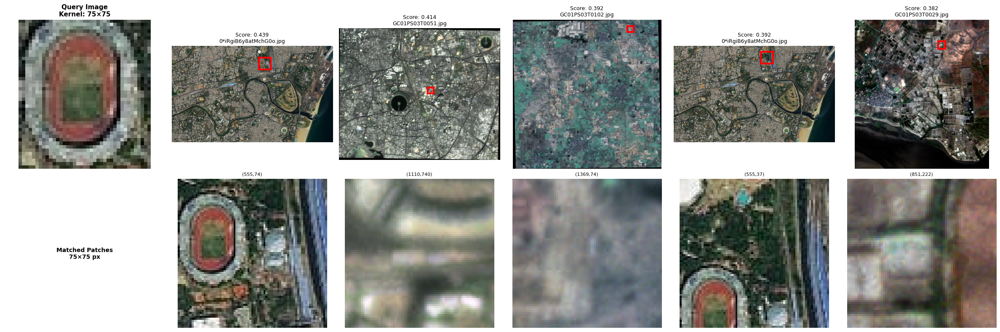


📊 Visualizing kernel 85×85


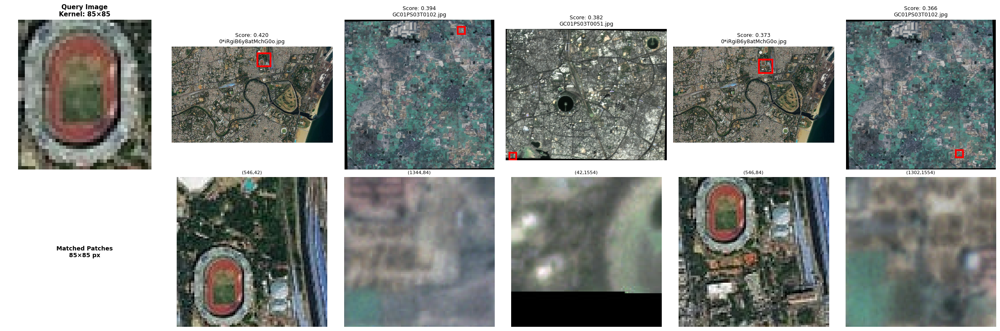


📊 Visualizing kernel 95×95


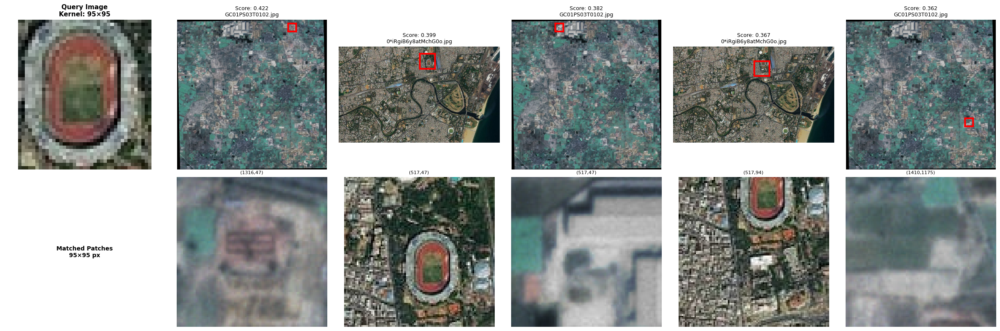


📊 Creating combined visualization...

Creating COMBINED visualization with all kernel sizes


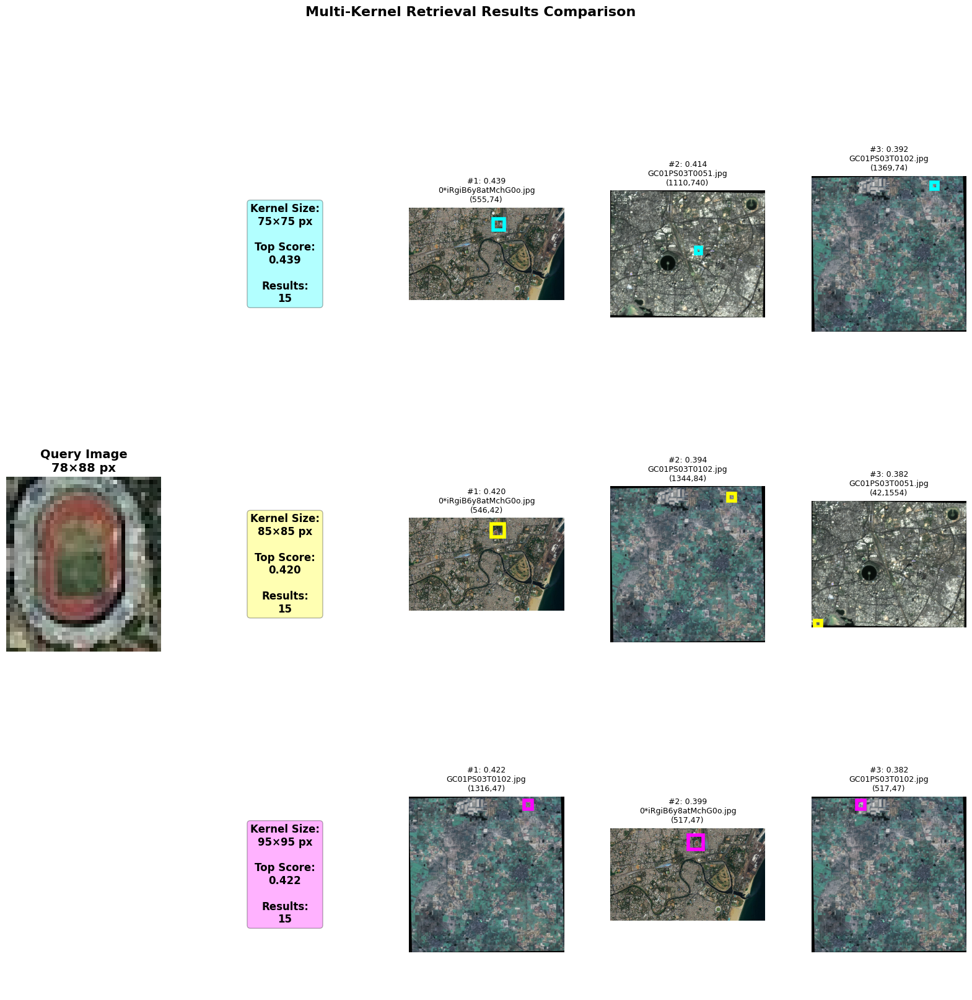


🔗 Merging overlapping patches...

MERGING OVERLAPPING PATCHES FROM ALL KERNELS
Total patches across all kernels: 45
After merging: 27 unified regions

📊 Merged Patches Summary:
  1. 0*iRgiB6y8atMchG0o.jpg
     Size: 114×152 px | Scores: avg=0.394, max=0.439
     Combined from 8 patches (kernels: 85×85, 95×95, 75×75)
  2. GC01PS03T0051.jpg
     Size: 112×75 px | Scores: avg=0.389, max=0.414
     Combined from 2 patches (kernels: 75×75)
  3. GC01PS03T0102.jpg
     Size: 184×132 px | Scores: avg=0.387, max=0.422
     Combined from 5 patches (kernels: 85×85, 95×95, 75×75)
  4. GC01PS03T0029.jpg
     Size: 75×75 px | Scores: avg=0.382, max=0.382
     Combined from 1 patches (kernels: 75×75)
  5. GC01PS03T0102.jpg
     Size: 108×100 px | Scores: avg=0.374, max=0.382
     Combined from 2 patches (kernels: 85×85, 95×95)
  6. GC01PS03T0102.jpg
     Size: 75×75 px | Scores: avg=0.369, max=0.369
     Combined from 1 patches (kernels: 75×75)
  7. GC01PS03T0102.jpg
     Size: 75×75 px | Scores: av

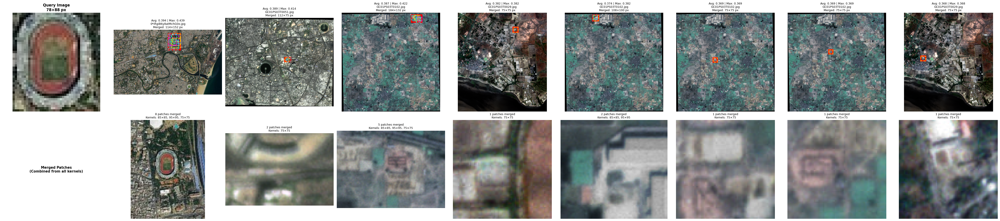


Query Complete!



In [2]:
output = quick_query_multi_kernel(
        query_image_path="/home/amarjeet/Desktop/Retrieval_engine_for_satellite_images/Untitled_folder/01.png",
        index_prefix="multi_kernel_index",
        kernel_sizes=KERNEL_SIZES,
        compress_query=False,  # Set True to compress query
        target_size=(50, 50),
        top_k=15,
        merge_threshold=0.3,
        visualize_separate=True,   # Show individual kernel results
        visualize_combined=True,   # Show all kernels together
        visualize_merged=True      # Show merged patches
    )


Quick Multi-Kernel Query with Saved Indexes
Kernel sizes: [(75, 75), (85, 85), (95, 95)]
✓ Using original query
Loading DINOv3 model: facebook/dinov3-vitb16-pretrain-lvd1689m
DINOv3 model loaded. Hidden size: 768

📂 Loading pre-computed indexes...
  ✗ Failed to load kernel 75×75: [Errno 2] No such file or directory: 'multi_kernel_index_k75x75_metadata.json'
  ✗ Failed to load kernel 85×85: [Errno 2] No such file or directory: 'multi_kernel_index_k85x85_metadata.json'
  ✗ Failed to load kernel 95×95: [Errno 2] No such file or directory: 'multi_kernel_index_k95x95_metadata.json'

🔍 Searching with all loaded kernels...

Searching with all kernel sizes

🔍 Searching with kernel 75×75...
  ✅ Found 15 results. Top score: 0.8278

🔍 Searching with kernel 85×85...
  ✅ Found 15 results. Top score: 0.8080

🔍 Searching with kernel 95×95...
  ✅ Found 15 results. Top score: 0.8149

📊 Creating separate visualizations...

Creating separate visualizations for each kernel size

📊 Visualizing kernel 75×7

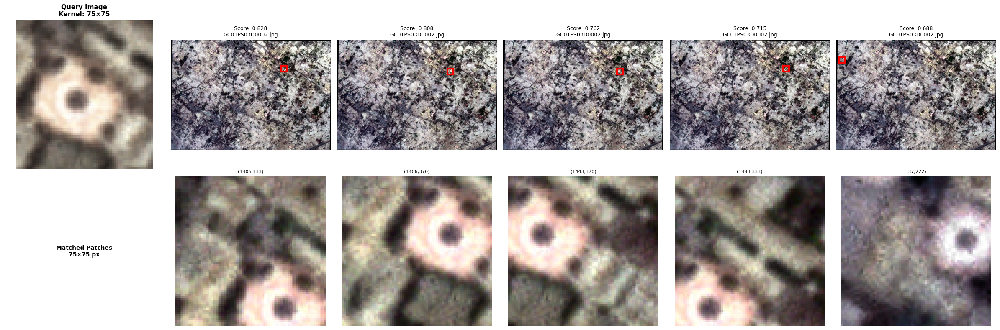


📊 Visualizing kernel 85×85


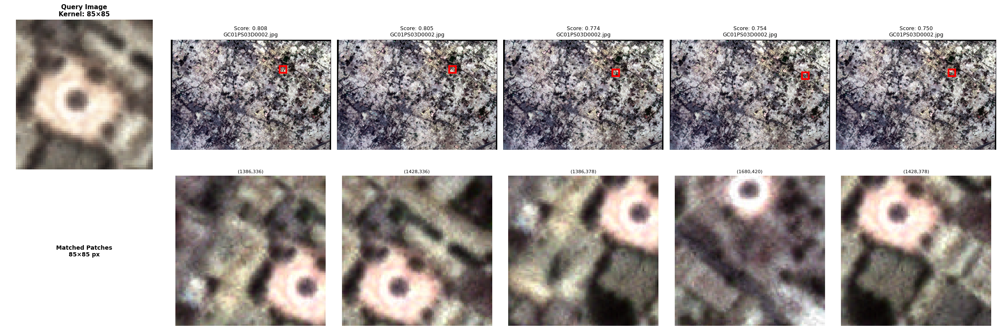


📊 Visualizing kernel 95×95


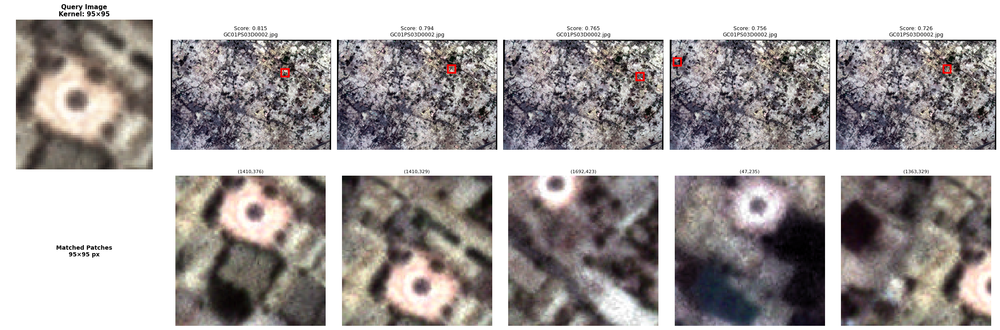


📊 Creating combined visualization...

Creating COMBINED visualization with all kernel sizes


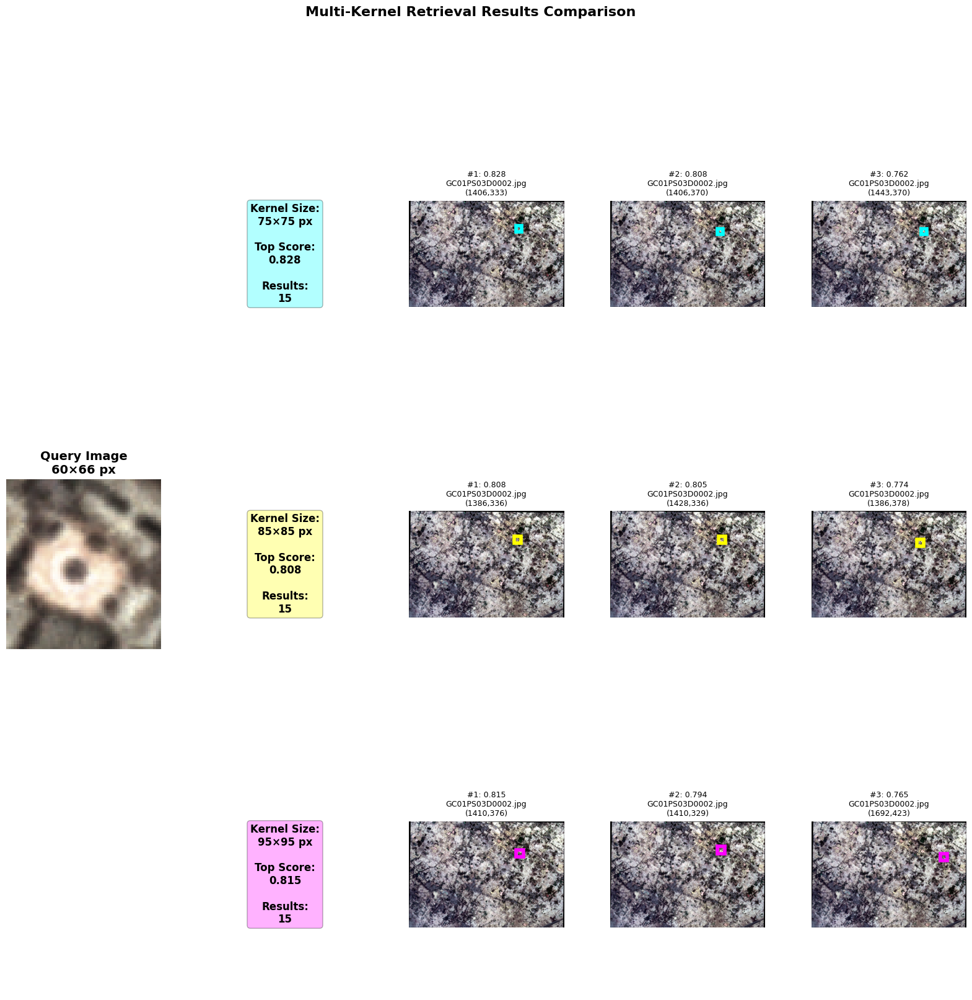


🔗 Merging overlapping patches...

MERGING OVERLAPPING PATCHES FROM ALL KERNELS
Total patches across all kernels: 45
After merging: 13 unified regions

📊 Merged Patches Summary:
  1. GC01PS03D0002.jpg
     Size: 95×95 px | Scores: avg=0.815, max=0.815
     Combined from 1 patches (kernels: 95×95)
  2. GC01PS03D0002.jpg
     Size: 155×142 px | Scores: avg=0.769, max=0.828
     Combined from 11 patches (kernels: 85×85, 95×95, 75×75)
  3. GC01PS03D0002.jpg
     Size: 169×148 px | Scores: avg=0.695, max=0.765
     Combined from 12 patches (kernels: 85×85, 95×95, 75×75)
  4. GC01PS03D0001.jpg
     Size: 85×85 px | Scores: avg=0.694, max=0.694
     Combined from 1 patches (kernels: 85×85)
  5. GC01PS03D0002.jpg
     Size: 85×127 px | Scores: avg=0.683, max=0.690
     Combined from 2 patches (kernels: 85×85)
  6. GC01PS03D0002.jpg
     Size: 152×152 px | Scores: avg=0.681, max=0.756
     Combined from 9 patches (kernels: 85×85, 95×95, 75×75)
  7. GC01PS03D0002.jpg
     Size: 95×95 px | Scores

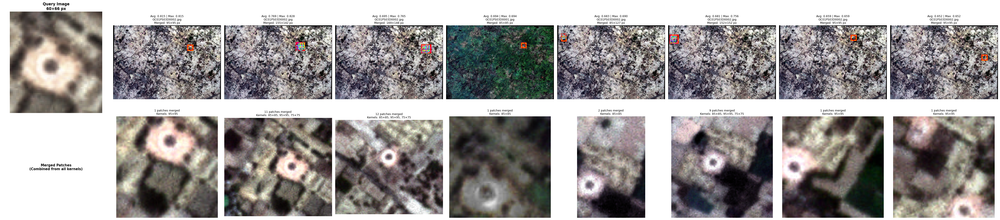


Query Complete!



In [3]:
output = quick_query_multi_kernel(
        query_image_path="/home/amarjeet/Desktop/Retrieval_engine_for_satellite_images/Untitled_folder/02.png",
        index_prefix="multi_kernel_index",
        kernel_sizes=KERNEL_SIZES,
        compress_query=False,  # Set True to compress query
        target_size=(50, 50),
        top_k=15,
        merge_threshold=0.3,
        visualize_separate=True,   # Show individual kernel results
        visualize_combined=True,   # Show all kernels together
        visualize_merged=True      # Show merged patches
    )


Quick Multi-Kernel Query with Saved Indexes
Kernel sizes: [(75, 75), (85, 85), (95, 95)]
✓ Using original query
Loading DINOv3 model: facebook/dinov3-vitb16-pretrain-lvd1689m
DINOv3 model loaded. Hidden size: 768

📂 Loading pre-computed indexes...
  ✗ Failed to load kernel 75×75: [Errno 2] No such file or directory: 'multi_kernel_index_k75x75_metadata.json'
  ✗ Failed to load kernel 85×85: [Errno 2] No such file or directory: 'multi_kernel_index_k85x85_metadata.json'
  ✗ Failed to load kernel 95×95: [Errno 2] No such file or directory: 'multi_kernel_index_k95x95_metadata.json'

🔍 Searching with all loaded kernels...

Searching with all kernel sizes

🔍 Searching with kernel 75×75...
  ✅ Found 15 results. Top score: 0.4652

🔍 Searching with kernel 85×85...
  ✅ Found 15 results. Top score: 0.4465

🔍 Searching with kernel 95×95...
  ✅ Found 15 results. Top score: 0.4694

📊 Creating separate visualizations...

Creating separate visualizations for each kernel size

📊 Visualizing kernel 75×7

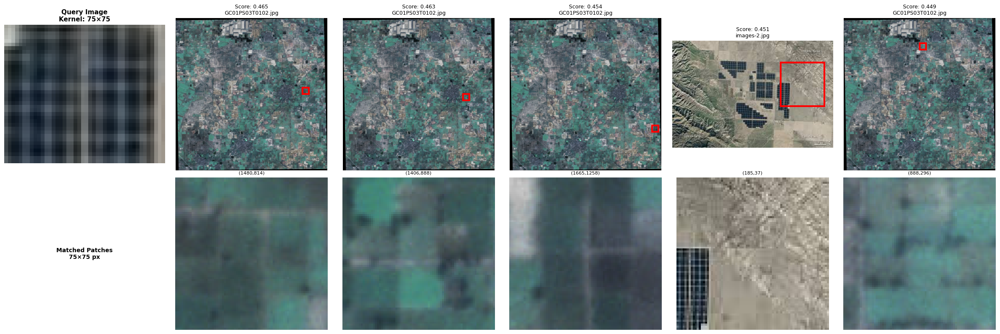


📊 Visualizing kernel 85×85


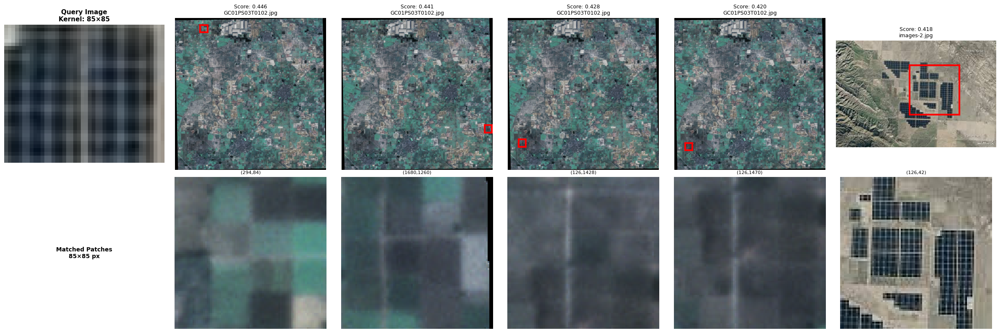


📊 Visualizing kernel 95×95


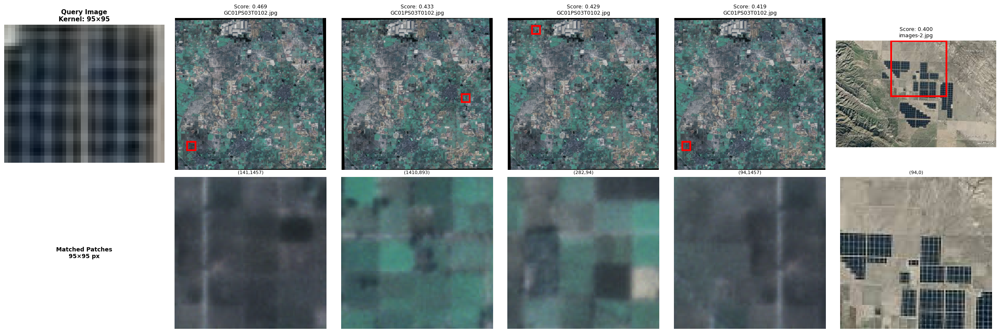


📊 Creating combined visualization...

Creating COMBINED visualization with all kernel sizes


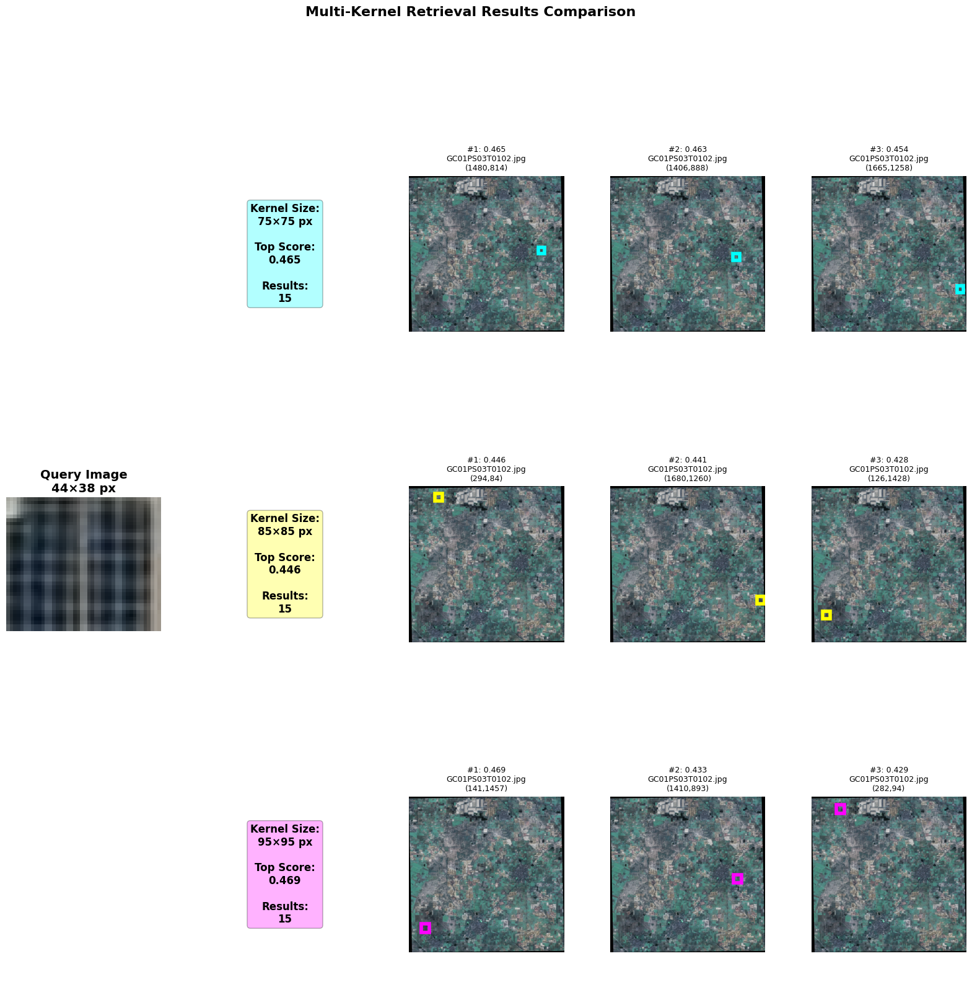


🔗 Merging overlapping patches...

MERGING OVERLAPPING PATCHES FROM ALL KERNELS
Total patches across all kernels: 45
After merging: 21 unified regions

📊 Merged Patches Summary:
  1. GC01PS03T0102.jpg
     Size: 75×75 px | Scores: avg=0.465, max=0.465
     Combined from 1 patches (kernels: 75×75)
  2. images-2.jpg
     Size: 75×75 px | Scores: avg=0.451, max=0.451
     Combined from 1 patches (kernels: 75×75)
  3. GC01PS03T0102.jpg
     Size: 100×87 px | Scores: avg=0.447, max=0.454
     Combined from 2 patches (kernels: 85×85, 75×75)
  4. GC01PS03T0102.jpg
     Size: 75×75 px | Scores: avg=0.442, max=0.442
     Combined from 1 patches (kernels: 75×75)
  5. GC01PS03T0102.jpg
     Size: 142×100 px | Scores: avg=0.431, max=0.463
     Combined from 4 patches (kernels: 95×95, 75×75)
  6. GC01PS03T0102.jpg
     Size: 85×85 px | Scores: avg=0.430, max=0.449
     Combined from 2 patches (kernels: 85×85, 75×75)
  7. GC01PS03T0102.jpg
     Size: 75×75 px | Scores: avg=0.428, max=0.428
     Comb

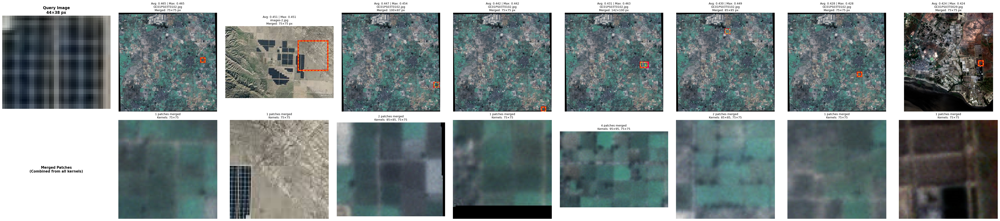


Query Complete!



In [4]:
output = quick_query_multi_kernel(
        query_image_path="/home/amarjeet/Desktop/Retrieval_engine_for_satellite_images/Untitled_folder/04.png",
        index_prefix="multi_kernel_index",
        kernel_sizes=KERNEL_SIZES,
        compress_query=False,  # Set True to compress query
        target_size=(50, 50),
        top_k=15,
        merge_threshold=0.3,
        visualize_separate=True,   # Show individual kernel results
        visualize_combined=True,   # Show all kernels together
        visualize_merged=True      # Show merged patches
    )


Quick Multi-Kernel Query with Saved Indexes
Kernel sizes: [(75, 75), (85, 85), (95, 95)]
✓ Using original query
Loading DINOv3 model: facebook/dinov3-vitb16-pretrain-lvd1689m
DINOv3 model loaded. Hidden size: 768

📂 Loading pre-computed indexes...
  ✗ Failed to load kernel 75×75: [Errno 2] No such file or directory: 'multi_kernel_index_k75x75_metadata.json'
  ✗ Failed to load kernel 85×85: [Errno 2] No such file or directory: 'multi_kernel_index_k85x85_metadata.json'
  ✗ Failed to load kernel 95×95: [Errno 2] No such file or directory: 'multi_kernel_index_k95x95_metadata.json'

🔍 Searching with all loaded kernels...

Searching with all kernel sizes

🔍 Searching with kernel 75×75...
  ✅ Found 15 results. Top score: 0.9641

🔍 Searching with kernel 85×85...
  ✅ Found 15 results. Top score: 0.9377

🔍 Searching with kernel 95×95...
  ✅ Found 15 results. Top score: 0.9357

📊 Creating separate visualizations...

Creating separate visualizations for each kernel size

📊 Visualizing kernel 75×7

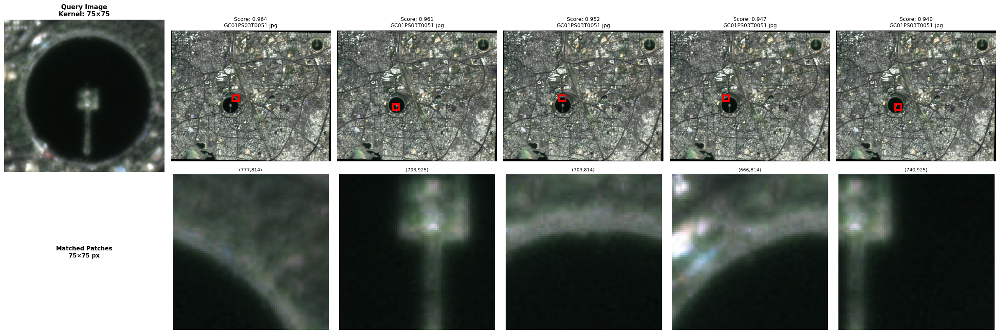


📊 Visualizing kernel 85×85


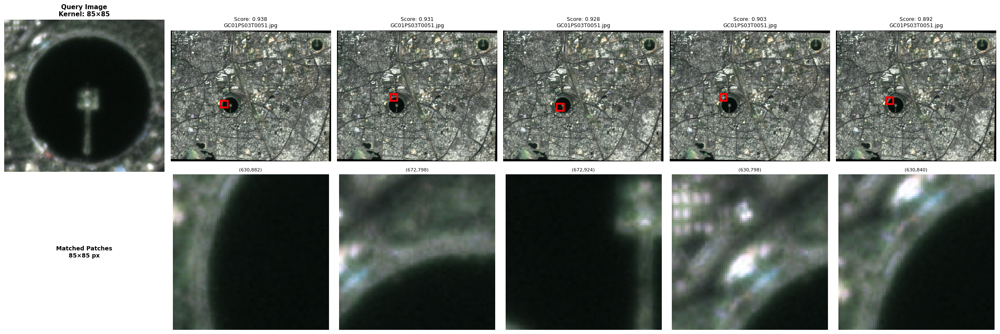


📊 Visualizing kernel 95×95


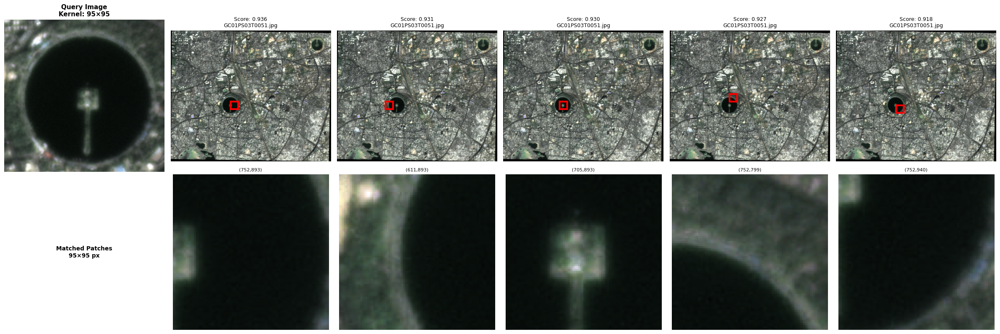


📊 Creating combined visualization...

Creating COMBINED visualization with all kernel sizes


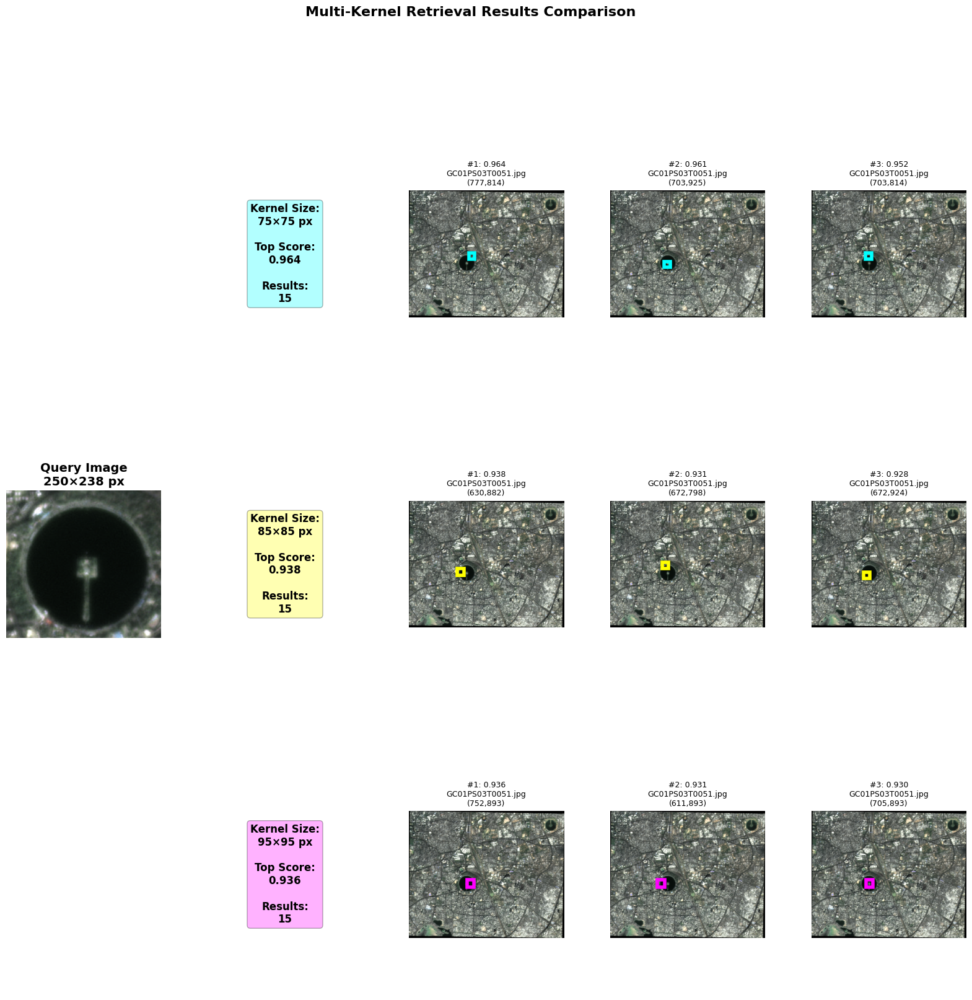


🔗 Merging overlapping patches...

MERGING OVERLAPPING PATCHES FROM ALL KERNELS
Total patches across all kernels: 45
After merging: 5 unified regions

📊 Merged Patches Summary:
  1. GC01PS03T0051.jpg
     Size: 167×143 px | Scores: avg=0.919, max=0.952
     Combined from 8 patches (kernels: 85×85, 95×95, 75×75)
  2. GC01PS03T0051.jpg
     Size: 127×200 px | Scores: avg=0.902, max=0.938
     Combined from 6 patches (kernels: 85×85, 95×95, 75×75)
  3. GC01PS03T0051.jpg
     Size: 75×112 px | Scores: avg=0.898, max=0.899
     Combined from 2 patches (kernels: 75×75)
  4. GC01PS03T0051.jpg
     Size: 264×200 px | Scores: avg=0.893, max=0.961
     Combined from 15 patches (kernels: 85×85, 95×95, 75×75)
  5. GC01PS03T0051.jpg
     Size: 272×169 px | Scores: avg=0.880, max=0.964
     Combined from 14 patches (kernels: 85×85, 95×95, 75×75)


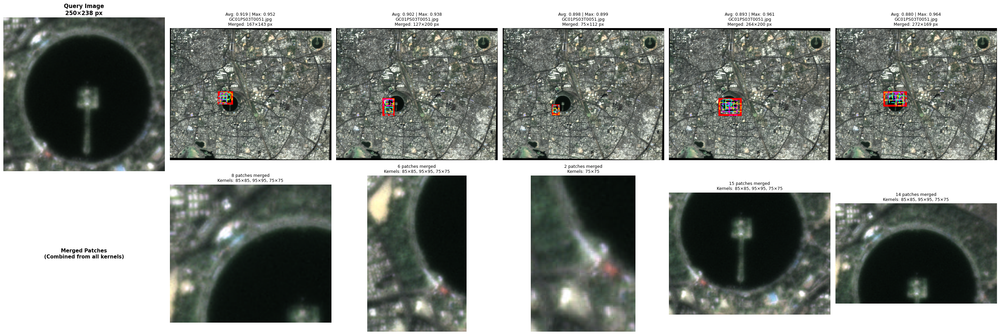


Query Complete!



In [5]:
output = quick_query_multi_kernel(
        query_image_path="/home/amarjeet/Desktop/Retrieval_engine_for_satellite_images/Untitled_folder/05.png",
        index_prefix="multi_kernel_index",
        kernel_sizes=KERNEL_SIZES,
        compress_query=False,  # Set True to compress query
        target_size=(50, 50),
        top_k=15,
        merge_threshold=0.3,
        visualize_separate=True,   # Show individual kernel results
        visualize_combined=True,   # Show all kernels together
        visualize_merged=True      # Show merged patches
    )


Quick Multi-Kernel Query with Saved Indexes
Kernel sizes: [(75, 75), (85, 85), (95, 95)]
✓ Using original query
Loading DINOv3 model: facebook/dinov3-vitb16-pretrain-lvd1689m
DINOv3 model loaded. Hidden size: 768

📂 Loading pre-computed indexes...
  ✗ Failed to load kernel 75×75: [Errno 2] No such file or directory: 'multi_kernel_index_k75x75_metadata.json'
  ✗ Failed to load kernel 85×85: [Errno 2] No such file or directory: 'multi_kernel_index_k85x85_metadata.json'
  ✗ Failed to load kernel 95×95: [Errno 2] No such file or directory: 'multi_kernel_index_k95x95_metadata.json'

🔍 Searching with all loaded kernels...

Searching with all kernel sizes

🔍 Searching with kernel 75×75...
  ✅ Found 15 results. Top score: 0.7645

🔍 Searching with kernel 85×85...
  ✅ Found 15 results. Top score: 0.7747

🔍 Searching with kernel 95×95...
  ✅ Found 15 results. Top score: 0.7743

📊 Creating separate visualizations...

Creating separate visualizations for each kernel size

📊 Visualizing kernel 75×7

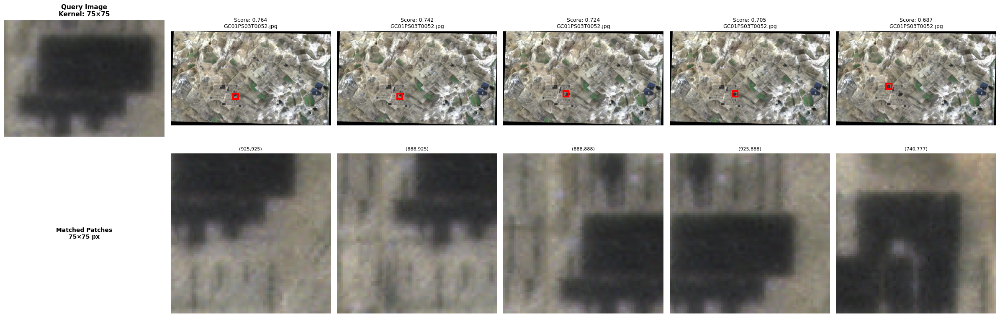


📊 Visualizing kernel 85×85


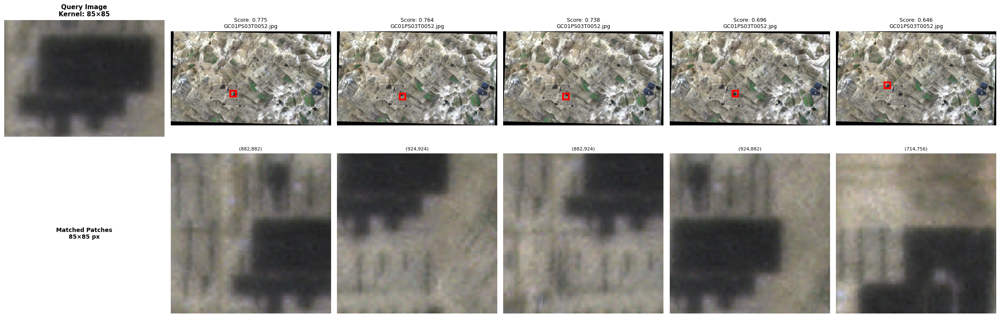


📊 Visualizing kernel 95×95


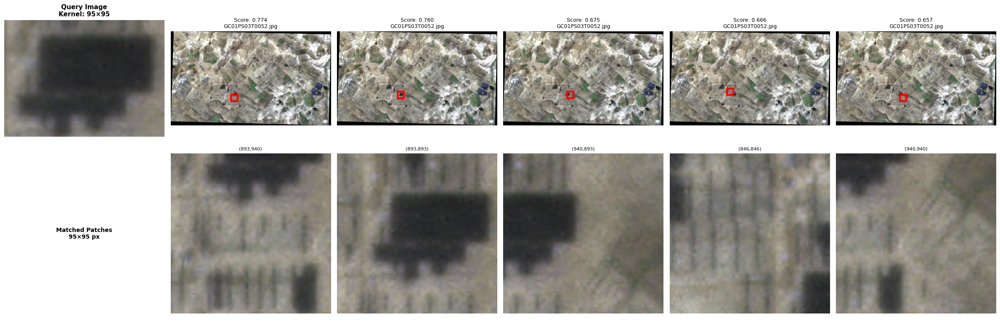


📊 Creating combined visualization...

Creating COMBINED visualization with all kernel sizes


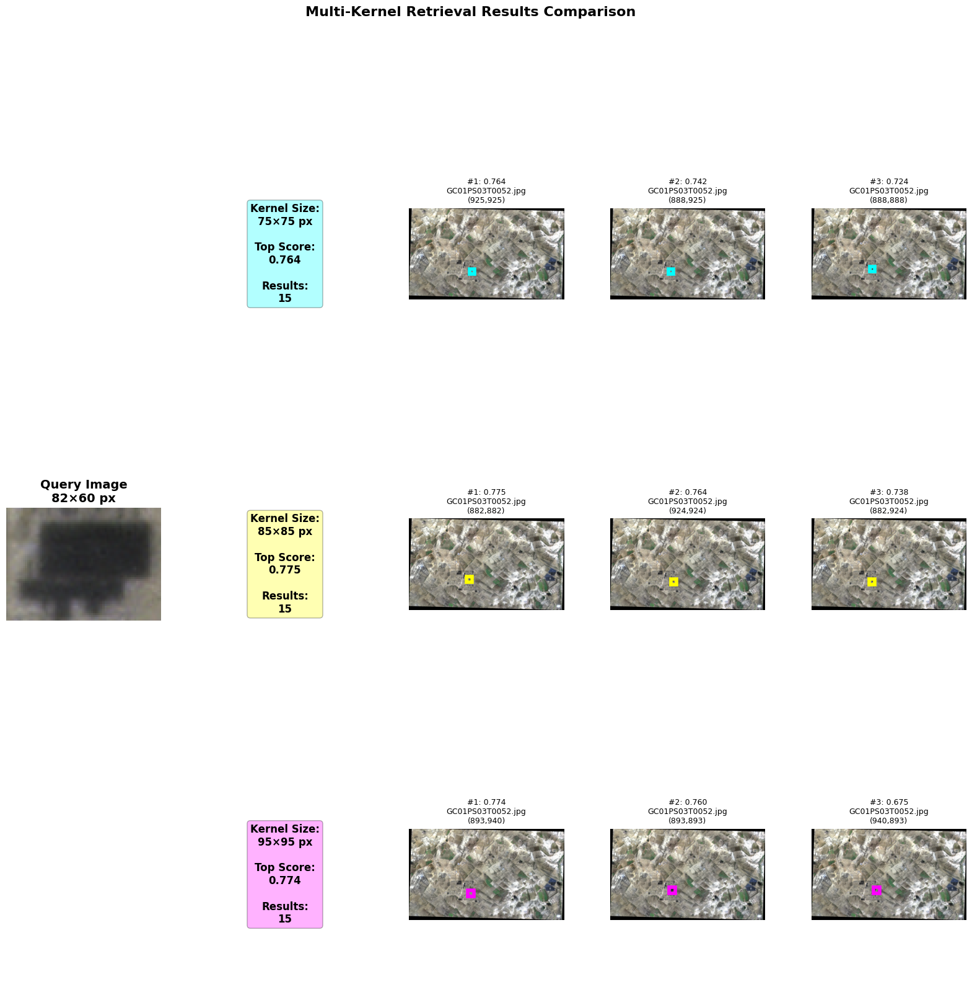


🔗 Merging overlapping patches...

MERGING OVERLAPPING PATCHES FROM ALL KERNELS
Total patches across all kernels: 45
After merging: 10 unified regions

📊 Merged Patches Summary:
  1. GC01PS03T0052.jpg
     Size: 116×111 px | Scores: avg=0.767, max=0.774
     Combined from 3 patches (kernels: 85×85, 95×95, 75×75)
  2. GC01PS03T0052.jpg
     Size: 195×234 px | Scores: avg=0.648, max=0.775
     Combined from 21 patches (kernels: 85×85, 95×95, 75×75)
  3. GC01PS03T0052.jpg
     Size: 127×142 px | Scores: avg=0.609, max=0.666
     Combined from 4 patches (kernels: 85×85, 95×95, 75×75)
  4. GC01PS03T0052.jpg
     Size: 110×154 px | Scores: avg=0.607, max=0.687
     Combined from 6 patches (kernels: 85×85, 95×95, 75×75)
  5. GC01PS03T0052.jpg
     Size: 154×124 px | Scores: avg=0.599, max=0.616
     Combined from 5 patches (kernels: 85×85, 95×95, 75×75)
  6. GC01PS03T0052.jpg
     Size: 75×75 px | Scores: avg=0.580, max=0.580
     Combined from 1 patches (kernels: 75×75)
  7. GC01PS03T0102.jp

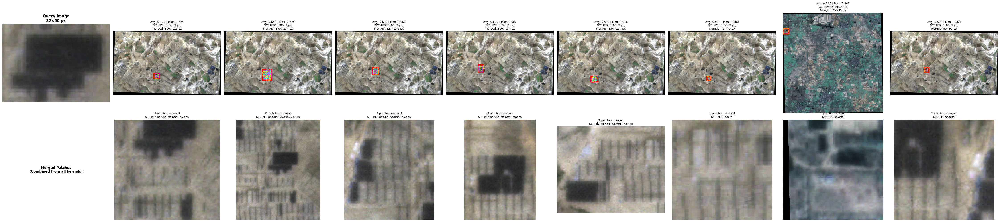


Query Complete!



In [6]:
output = quick_query_multi_kernel(
        query_image_path="/home/amarjeet/Desktop/Retrieval_engine_for_satellite_images/Untitled_folder/06.png",
        index_prefix="multi_kernel_index",
        kernel_sizes=KERNEL_SIZES,
        compress_query=False,  # Set True to compress query
        target_size=(50, 50),
        top_k=15,
        merge_threshold=0.3,
        visualize_separate=True,   # Show individual kernel results
        visualize_combined=True,   # Show all kernels together
        visualize_merged=True      # Show merged patches
    )